# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [4]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [5]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [6]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [7]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [8]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [9]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = ((gradient_norm - 1)**2).mean()
    #### END CODE HERE ####
    return penalty

In [10]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [11]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -crit_fake_pred.mean()
    #### END CODE HERE ####
    return gen_loss

In [12]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp*c_lambda
    #### END CODE HERE ####
    return crit_loss

In [14]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.08103510903194547, critic loss: 1.9273522550761688


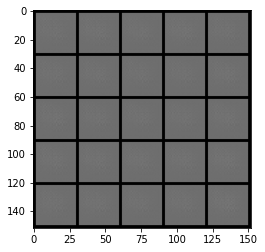

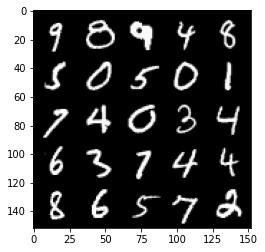

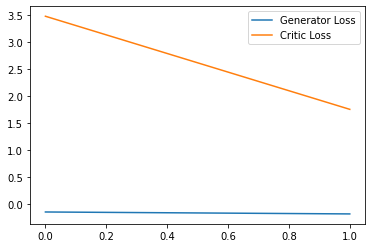

Step 100: Generator loss: 1.2543473622202874, critic loss: -2.370692231923341


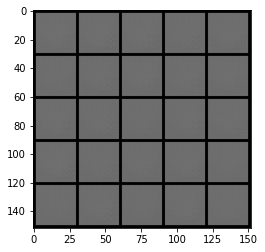

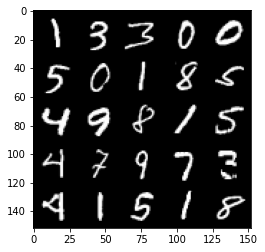

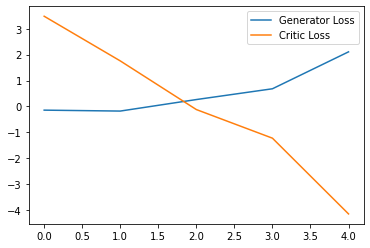

Step 150: Generator loss: 2.67771400809288, critic loss: -11.980642059326174


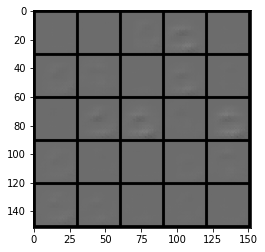

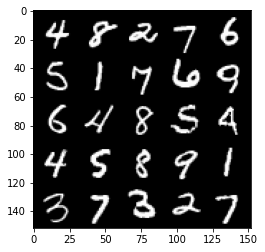

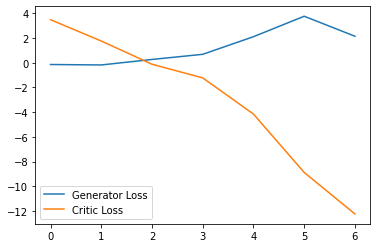

Step 200: Generator loss: -1.4533203882724046, critic loss: -28.957003639221185


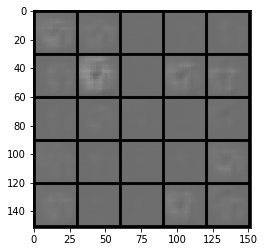

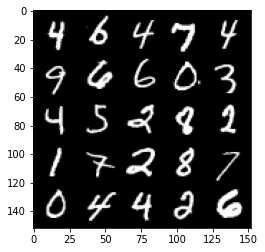

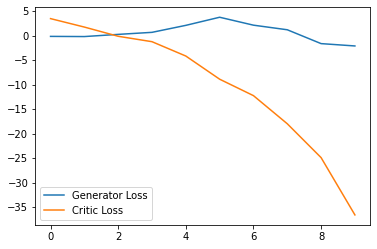

Step 250: Generator loss: -3.3330141639709474, critic loss: -63.066704765319834


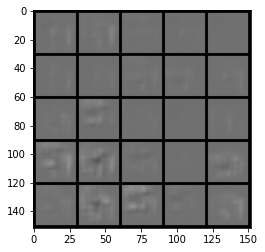

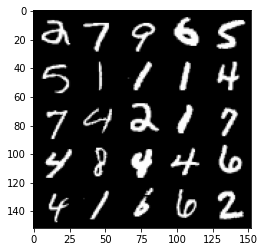

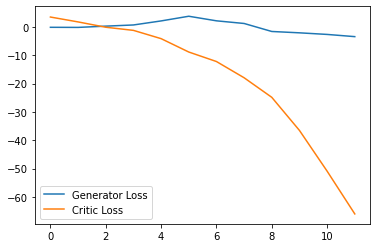

Step 300: Generator loss: -4.851211185455322, critic loss: -109.77218768310547


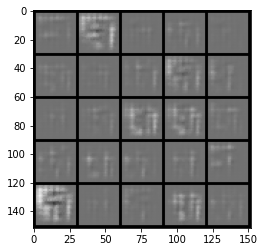

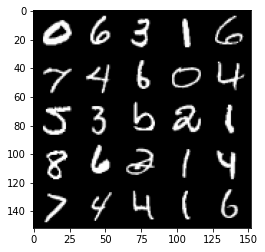

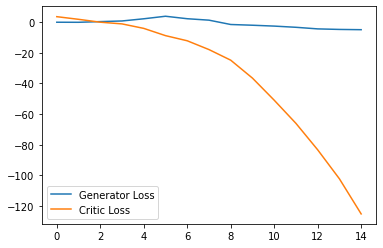

Step 350: Generator loss: -4.116319341361523, critic loss: -161.18087237548824


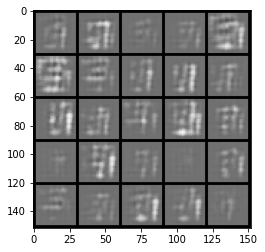

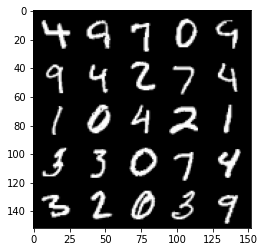

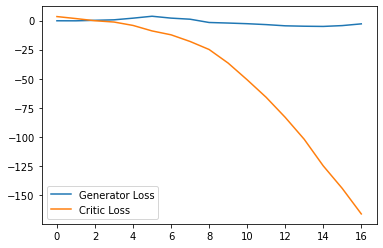

Step 400: Generator loss: -2.228943002820015, critic loss: -204.84133746337886


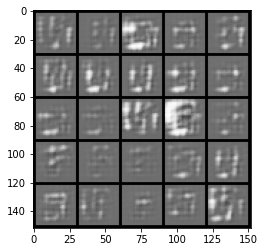

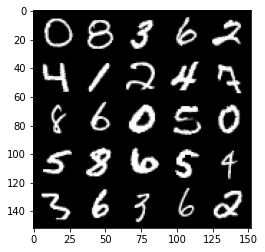

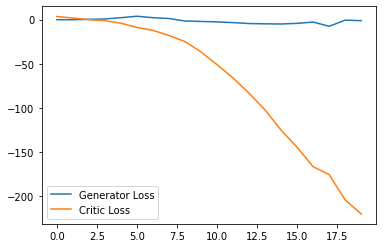

Step 450: Generator loss: -16.2326527428627, critic loss: -230.59309736633298


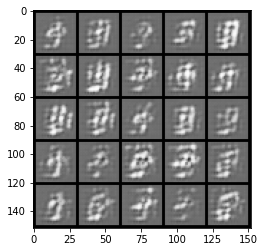

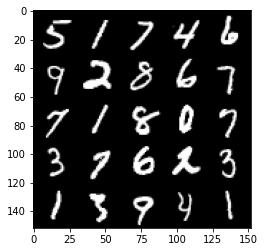

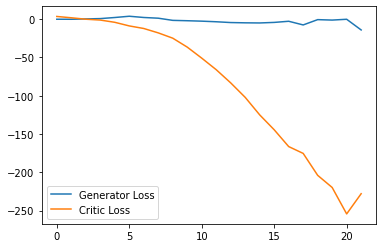

Step 500: Generator loss: 0.09046868920326233, critic loss: -225.53247673034667


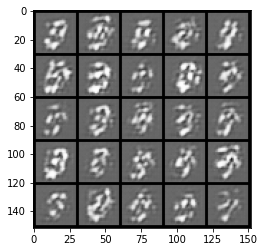

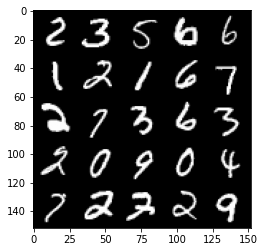

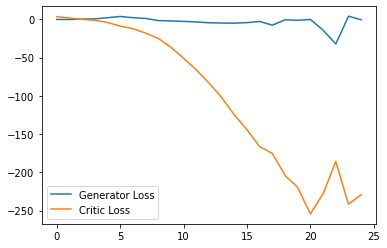

Step 550: Generator loss: 3.433473598957062, critic loss: -283.0216776733398


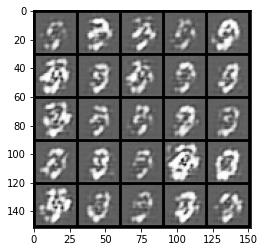

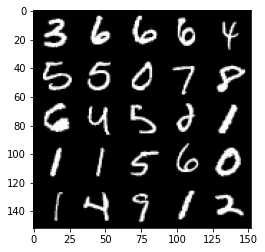

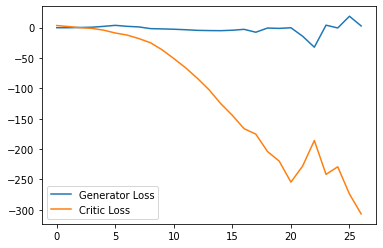

Step 600: Generator loss: -12.3057812166214, critic loss: -251.62553973388668


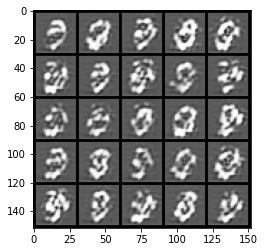

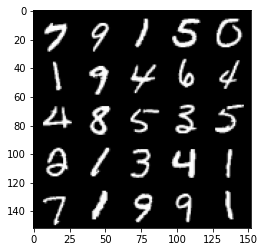

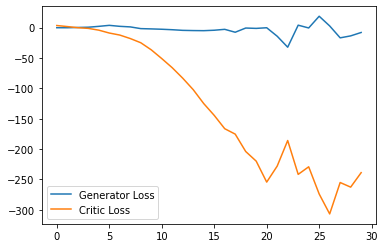

Step 650: Generator loss: -6.502221726179123, critic loss: -281.7509049682617


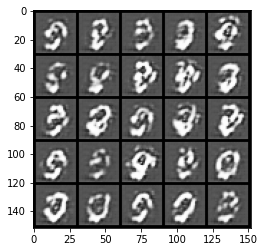

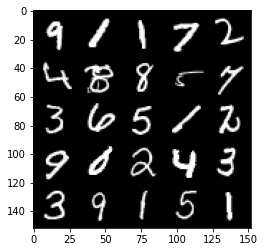

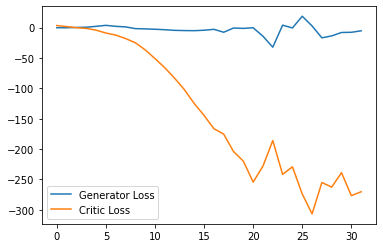

Step 700: Generator loss: -60.97029685974121, critic loss: -203.5331033477783


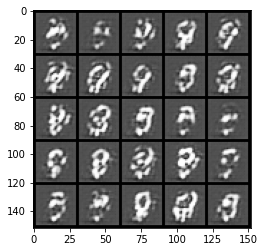

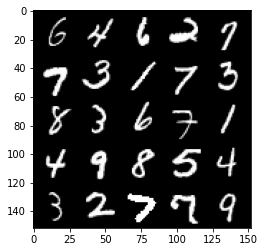

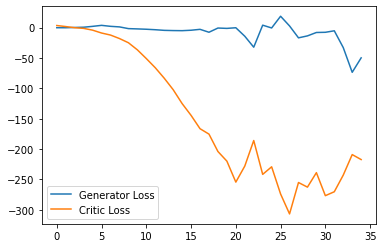

Step 750: Generator loss: -16.15576376438141, critic loss: -227.23623811340335


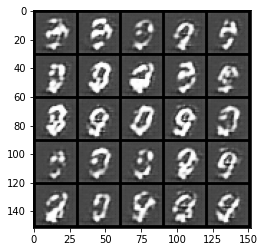

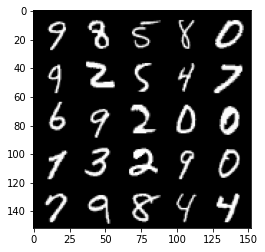

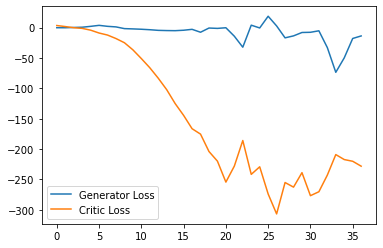

Step 800: Generator loss: -12.78902417421341, critic loss: -221.19836251831055


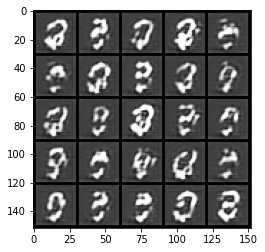

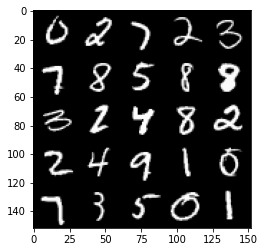

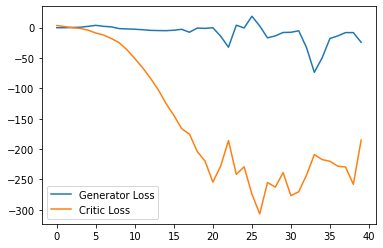

Step 850: Generator loss: -41.188295535445214, critic loss: -166.26248063659662


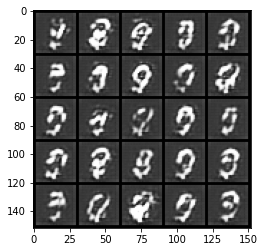

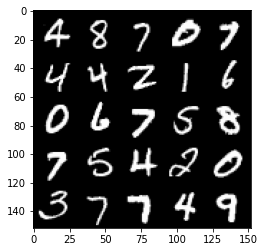

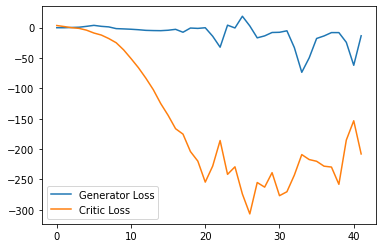

Step 900: Generator loss: -29.415880863666533, critic loss: -171.17097244262692


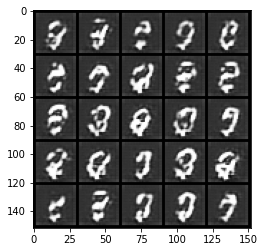

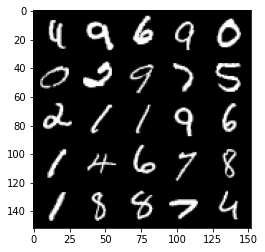

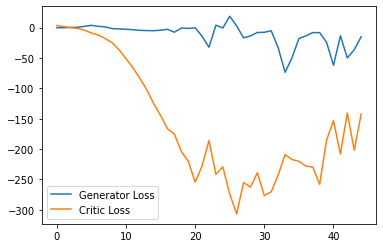

Step 950: Generator loss: -28.543620179891587, critic loss: -92.12940267181399


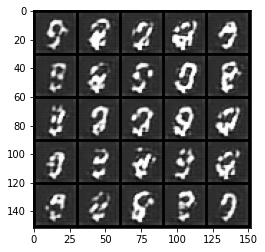

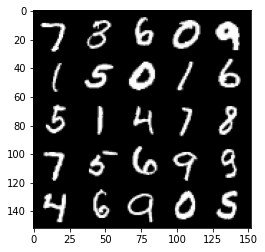

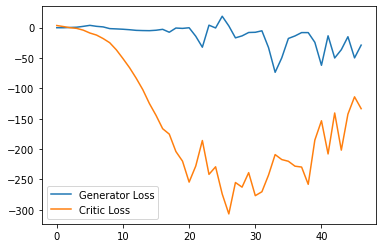

Step 1000: Generator loss: -15.218842476606369, critic loss: -34.30633533477782


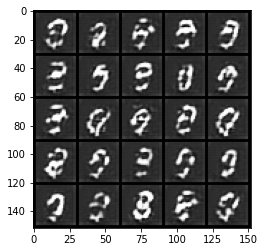

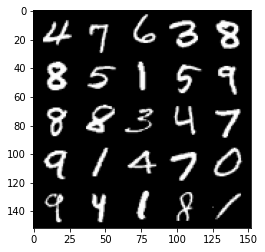

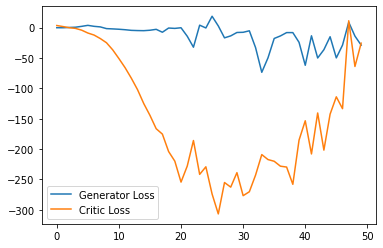

Step 1050: Generator loss: 21.530364379882812, critic loss: 31.187779209136963


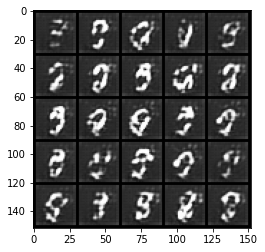

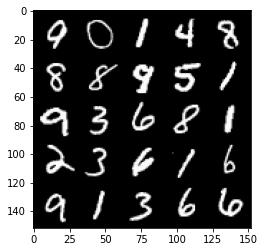

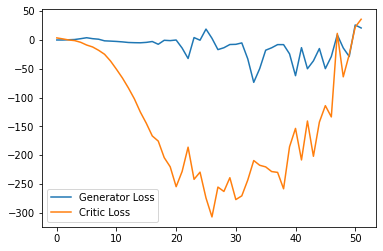

Step 1100: Generator loss: 8.220085229873657, critic loss: 28.303994182586667


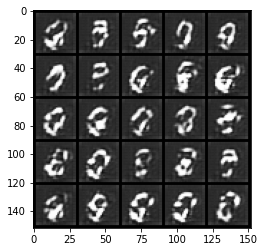

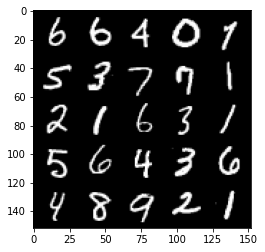

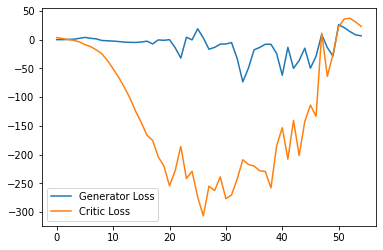

Step 1150: Generator loss: 6.421490058898926, critic loss: 14.22903981781006


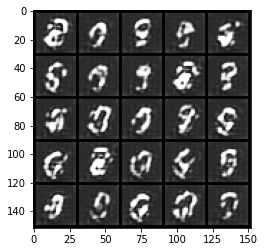

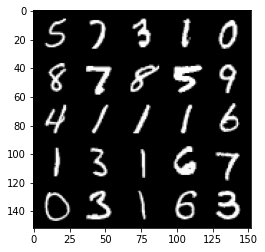

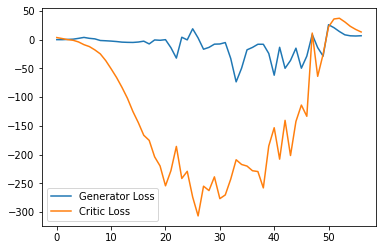

Step 1200: Generator loss: 6.662163133621216, critic loss: 5.533743280410766


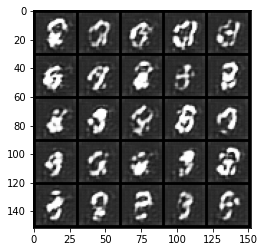

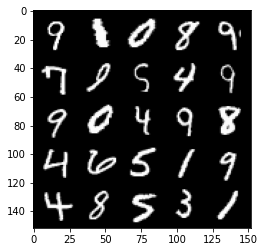

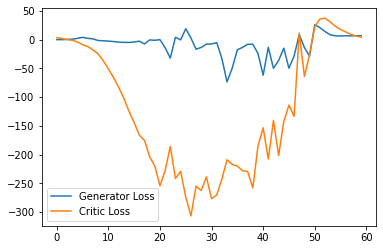

Step 1250: Generator loss: 6.121930990219116, critic loss: 3.3730512485504143


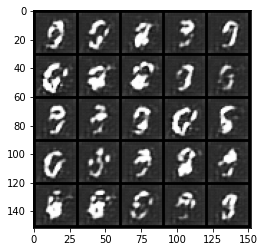

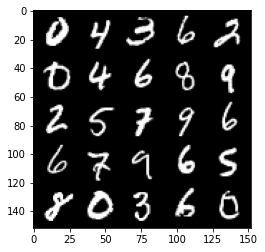

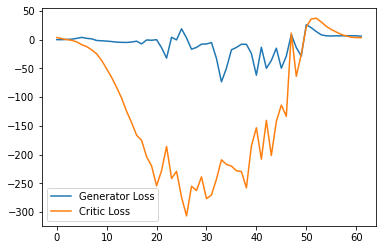

Step 1300: Generator loss: 4.905276823043823, critic loss: 1.8402132244110103


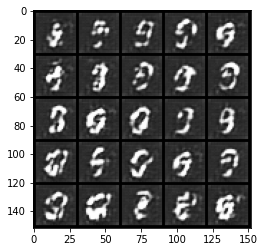

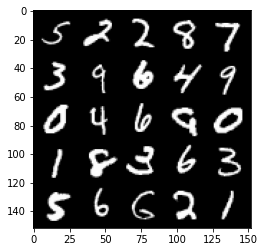

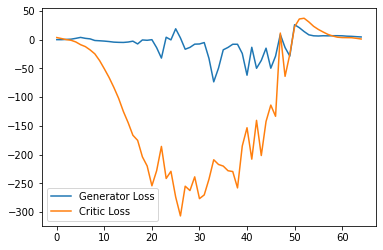

Step 1350: Generator loss: 2.8390028154850007, critic loss: -0.32208943557739267


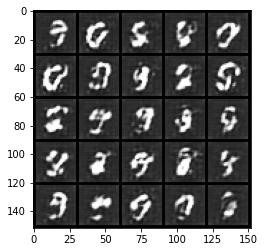

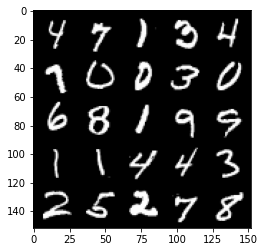

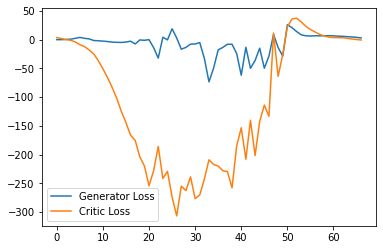

Step 1400: Generator loss: -1.1972829063236714, critic loss: 2.457835325241089


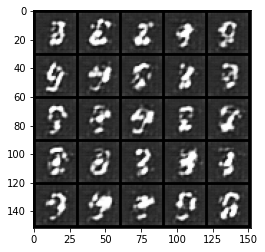

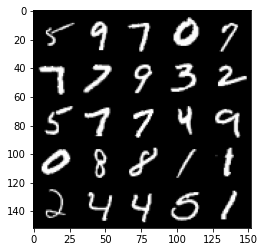

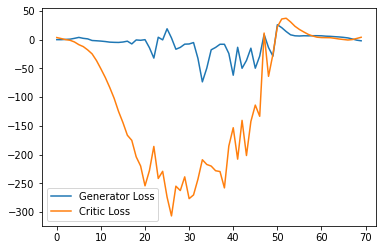

Step 1450: Generator loss: -3.4217228177189827, critic loss: 4.925900104522705


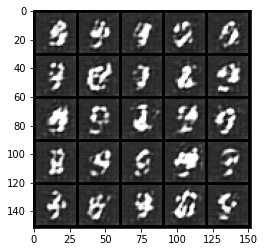

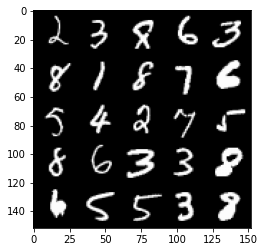

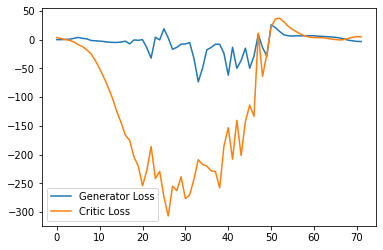

Step 1500: Generator loss: -5.666153907775879, critic loss: 3.9507605628967286


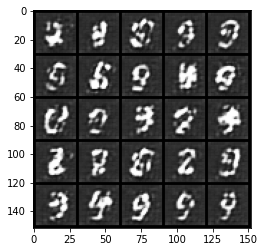

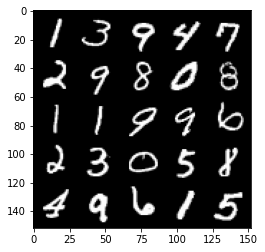

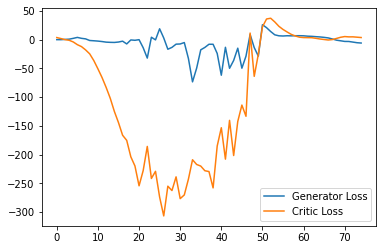

Step 1550: Generator loss: -6.948528571128845, critic loss: 1.7814323921203608


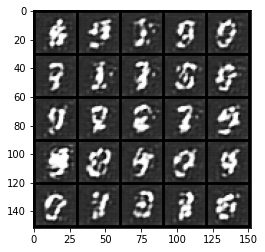

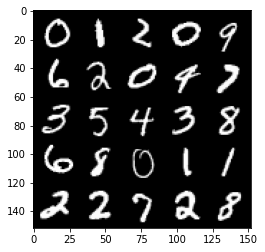

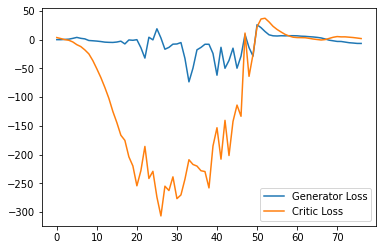

Step 1600: Generator loss: -6.623425786495209, critic loss: -0.7080622062683104


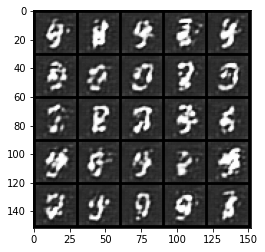

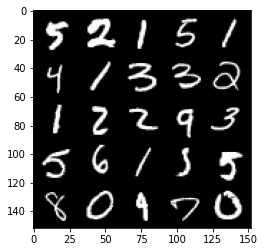

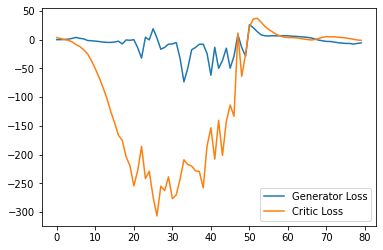

Step 1650: Generator loss: -5.9730811816453935, critic loss: -3.861200778961181


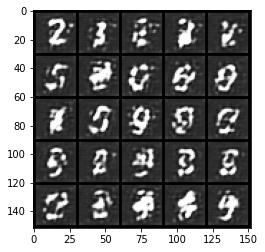

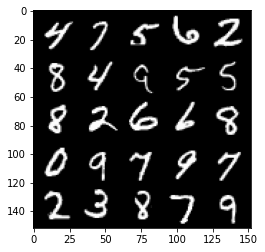

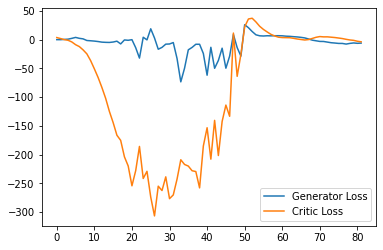

Step 1700: Generator loss: -4.881774959564209, critic loss: -6.472927070617675


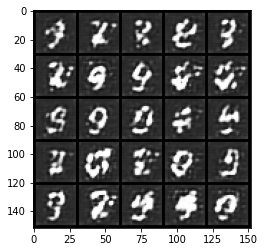

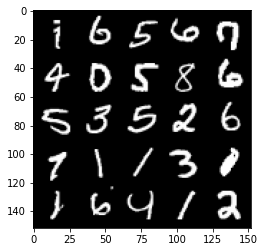

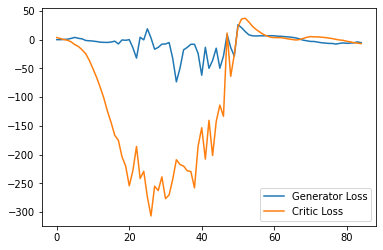

Step 1750: Generator loss: -5.051199317872524, critic loss: -9.636505632400512


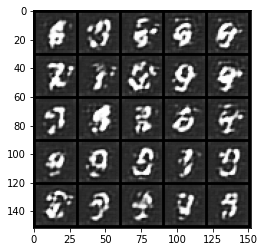

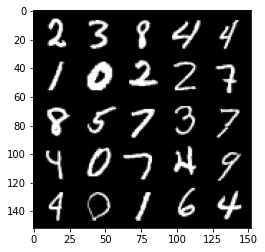

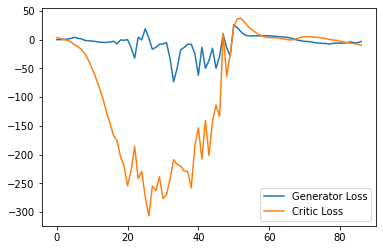

Step 1800: Generator loss: -3.767463899254799, critic loss: -12.611562618255613


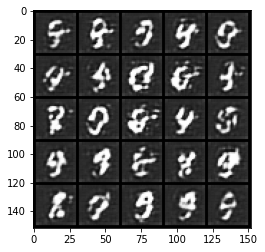

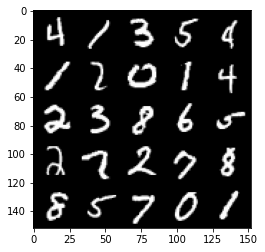

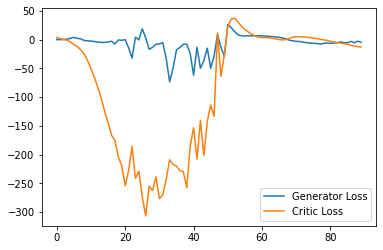

Step 1850: Generator loss: -1.8445062431693078, critic loss: -15.891091140747069


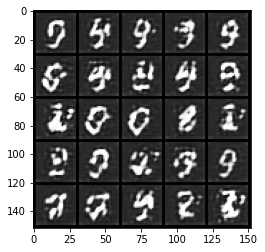

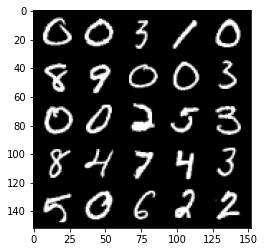

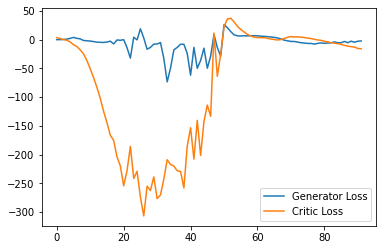

Step 1900: Generator loss: -1.9178479206562042, critic loss: -19.44714808273316


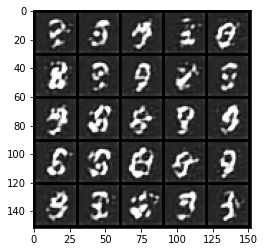

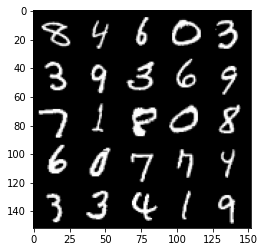

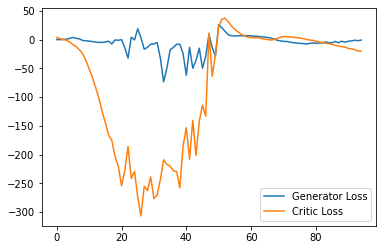

Step 1950: Generator loss: 1.1293799477815627, critic loss: -19.232269344329833


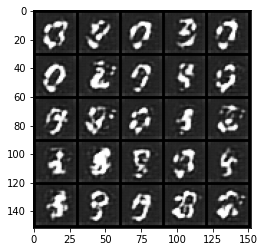

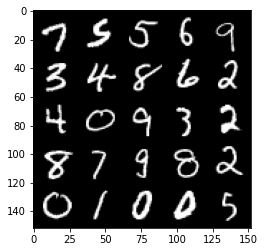

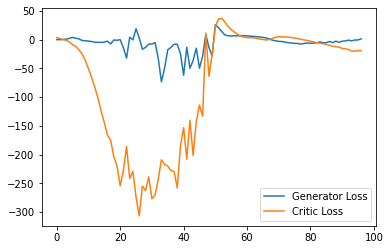

Step 2000: Generator loss: 3.341452907025814, critic loss: -19.83244757843017


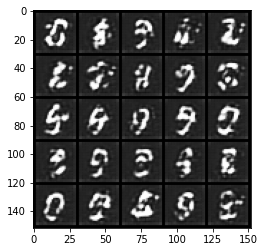

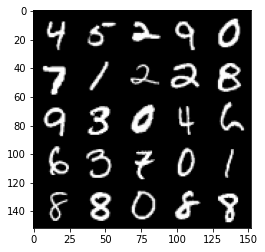

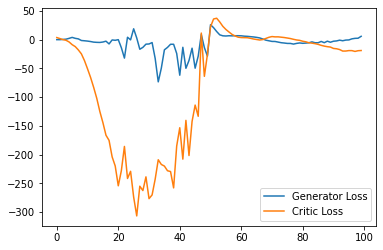

Step 2050: Generator loss: 2.3511688619852067, critic loss: -21.48418373298645


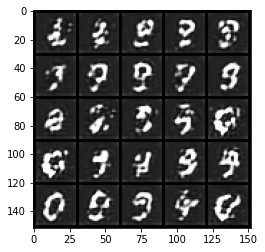

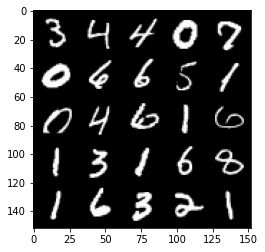

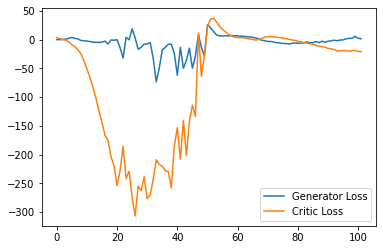

Step 2100: Generator loss: 5.03007267832756, critic loss: -22.345930690765375


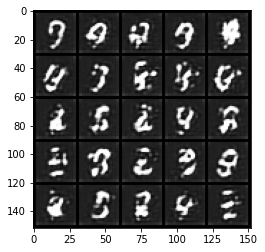

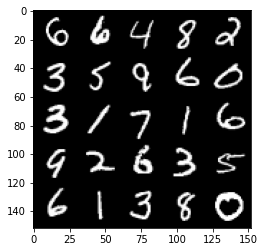

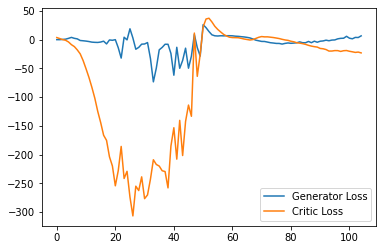

Step 2150: Generator loss: 6.14007192492485, critic loss: -22.814777072906498


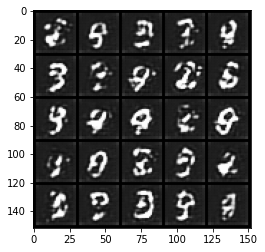

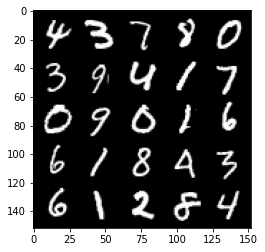

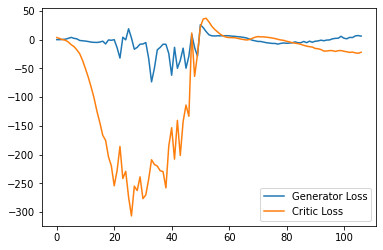

Step 2200: Generator loss: 6.571515284776687, critic loss: -22.539895408630365


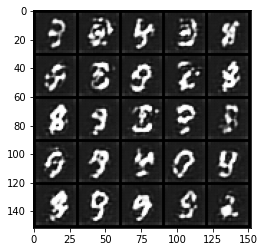

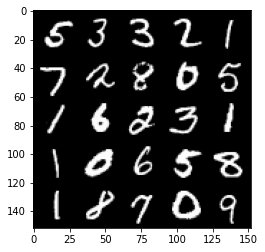

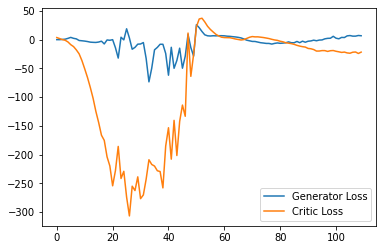

Step 2250: Generator loss: 9.49108636379242, critic loss: -24.609899869918824


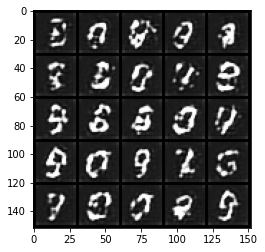

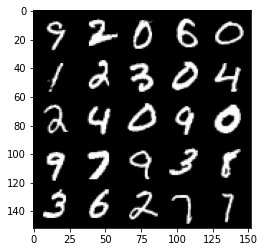

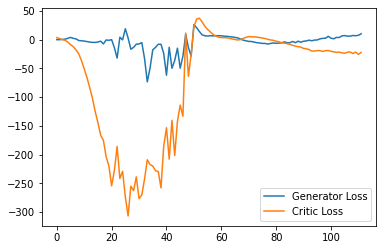

Step 2300: Generator loss: 6.708712810426951, critic loss: -18.646358379364013


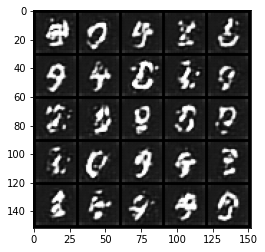

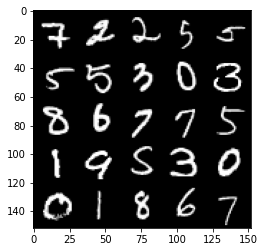

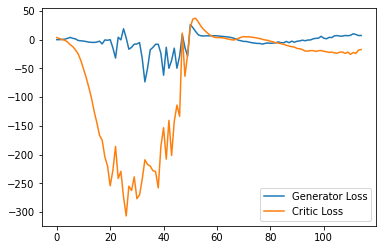

Step 2350: Generator loss: 11.68302041053772, critic loss: -13.964800711631774


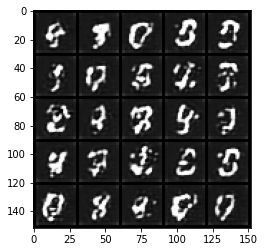

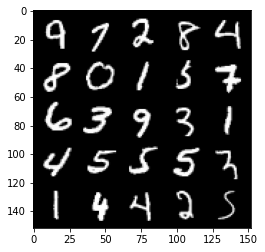

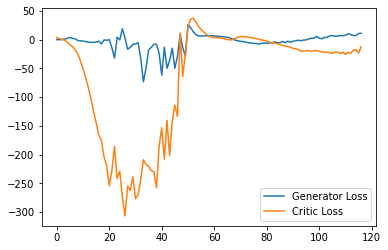

Step 2400: Generator loss: 10.324345932006835, critic loss: -1.7983408222198483


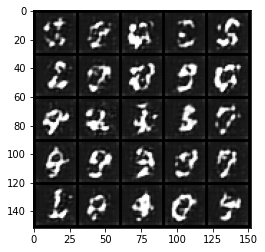

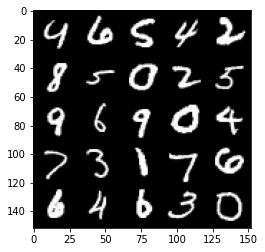

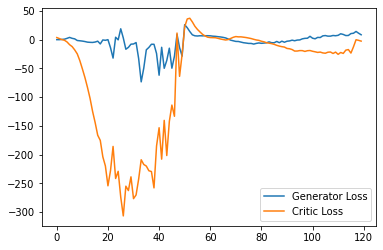

Step 2450: Generator loss: 3.06238426014781, critic loss: -15.057256836891174


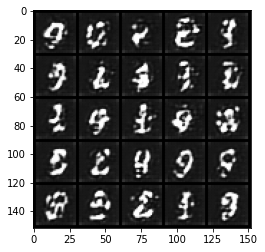

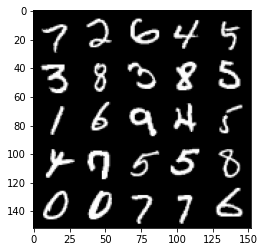

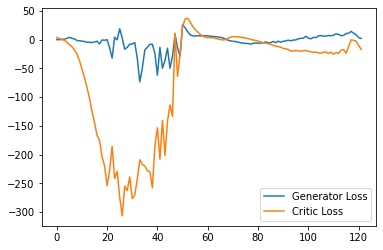

Step 2500: Generator loss: 8.2110795378685, critic loss: -13.621800806045533


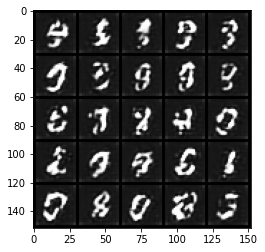

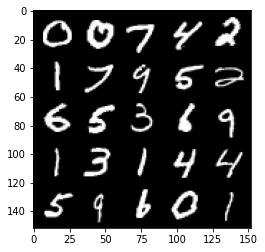

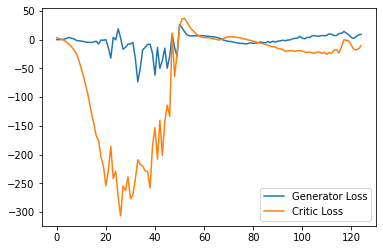

Step 2550: Generator loss: 9.127837791442872, critic loss: -7.954431212902068


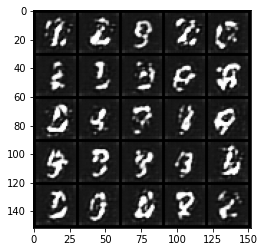

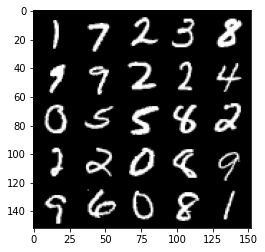

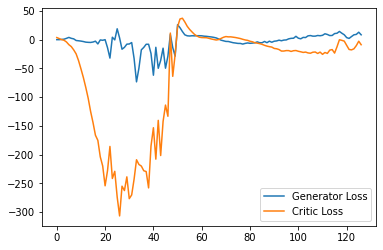

Step 2600: Generator loss: 6.615220079421997, critic loss: -16.961651219367983


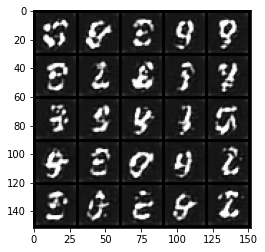

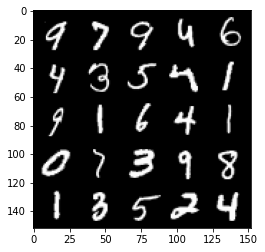

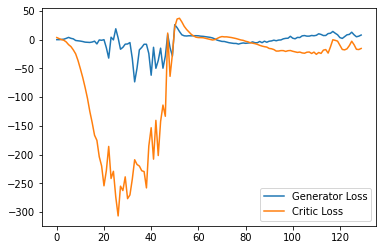

Step 2650: Generator loss: 9.788704884052276, critic loss: -10.27777100658417


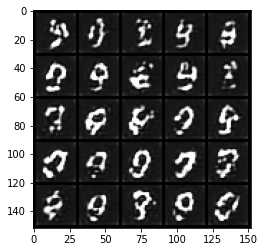

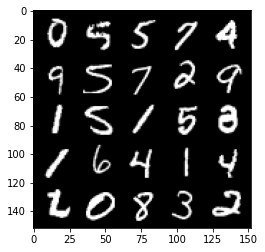

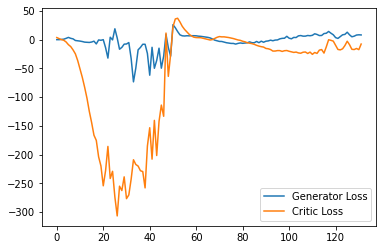

Step 2700: Generator loss: 11.356871099472047, critic loss: -4.020513437271119


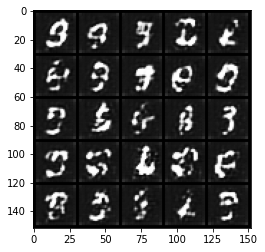

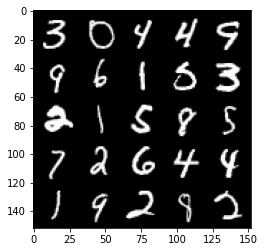

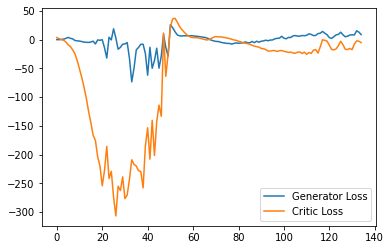

Step 2750: Generator loss: 4.237090995311737, critic loss: -15.553547809600827


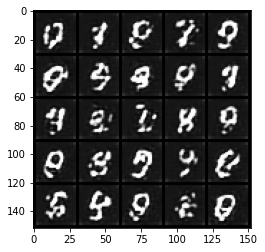

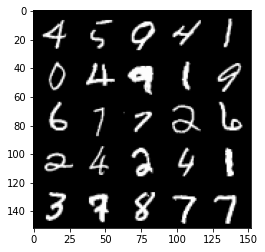

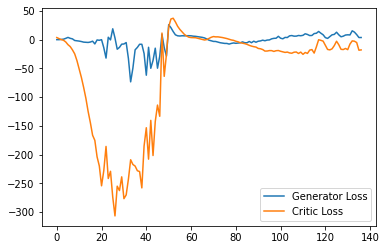

Step 2800: Generator loss: 8.223338423073292, critic loss: -16.245302612304684


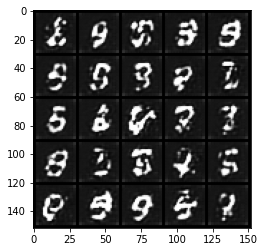

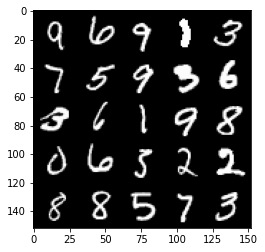

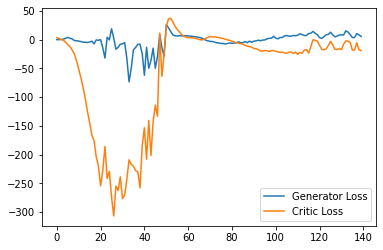

Step 2850: Generator loss: 8.844782537221908, critic loss: -15.044715508460998


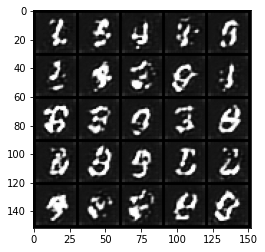

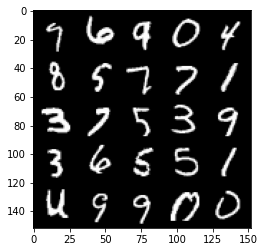

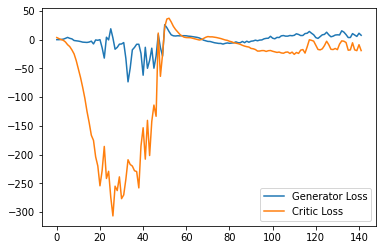

Step 2900: Generator loss: 8.211356222629547, critic loss: -18.49648707199097


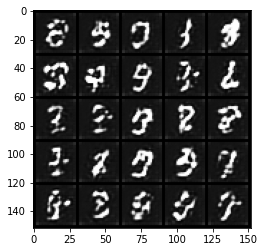

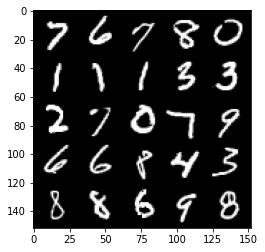

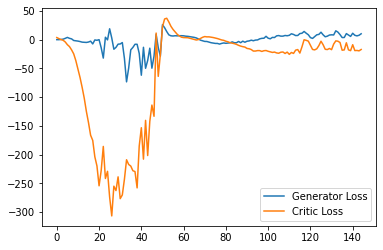

Step 2950: Generator loss: 12.205373053550721, critic loss: -13.586549268245697


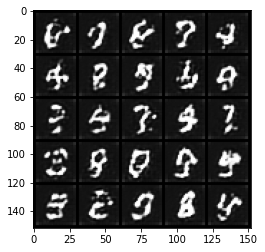

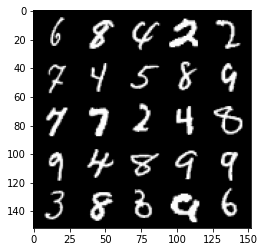

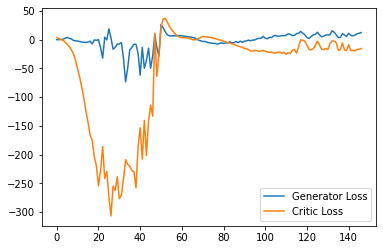

Step 3000: Generator loss: 16.196652708053588, critic loss: -9.241245402336121


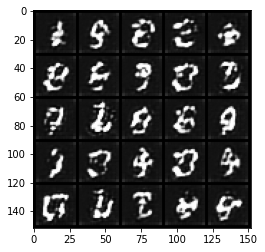

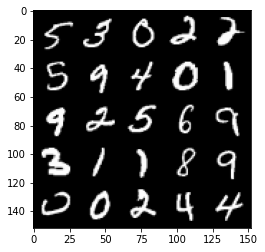

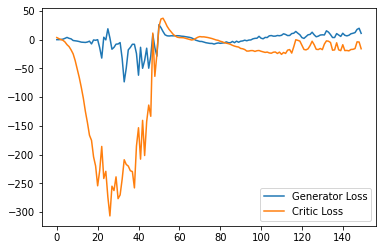

Step 3050: Generator loss: 13.103213429450989, critic loss: -11.929582197189333


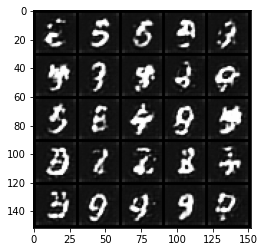

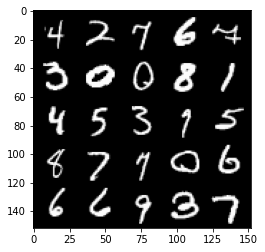

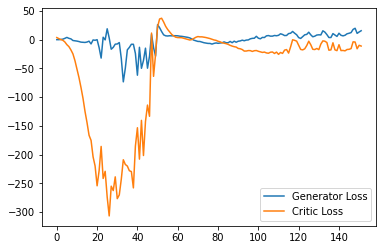

Step 3100: Generator loss: 16.23609272003174, critic loss: -6.459614713668823


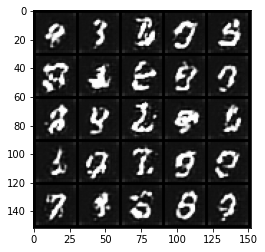

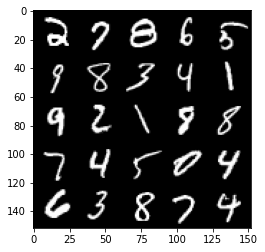

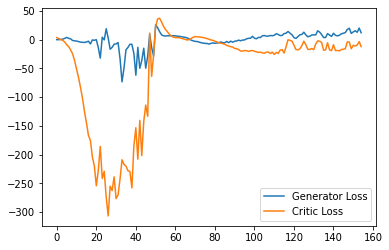

Step 3150: Generator loss: 10.904687423706054, critic loss: -17.073574033737188


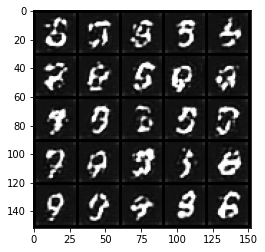

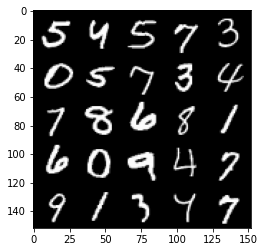

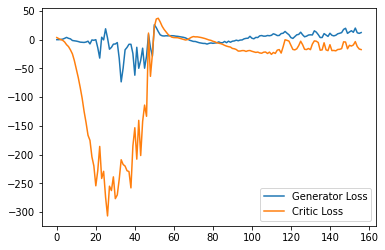

Step 3200: Generator loss: 10.271474164500832, critic loss: -18.35065736579895


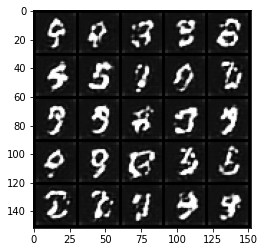

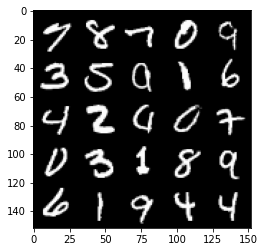

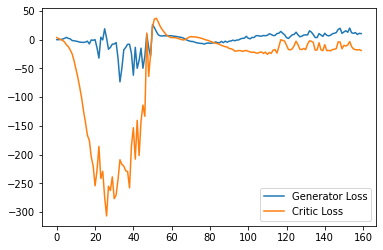

Step 3250: Generator loss: 11.32596872806549, critic loss: -16.80422245025635


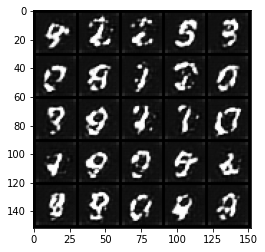

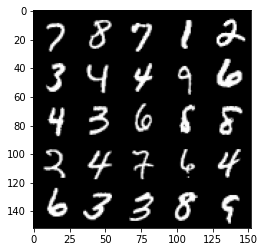

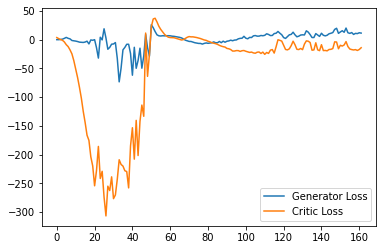

Step 3300: Generator loss: 12.631351766586304, critic loss: -14.045306983470919


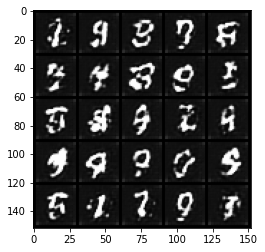

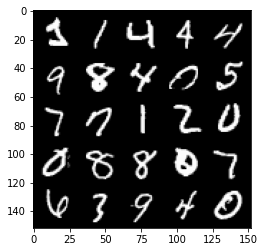

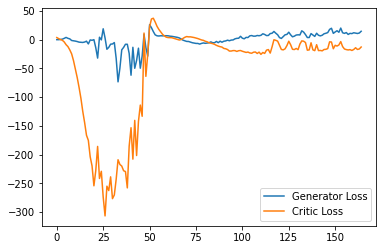

Step 3350: Generator loss: 15.489554271697997, critic loss: -9.985760828495025


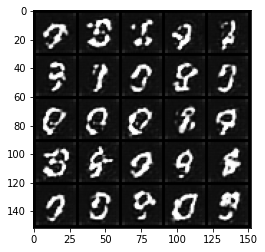

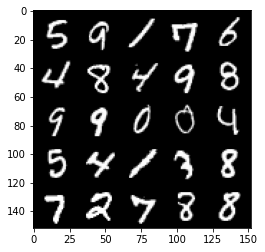

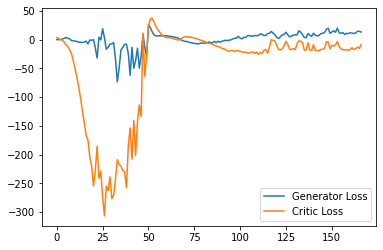

Step 3400: Generator loss: 17.868788108825683, critic loss: -2.9276142368316647


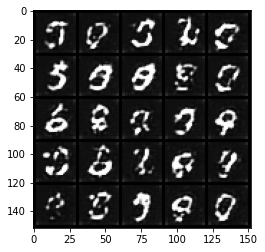

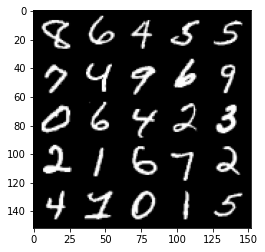

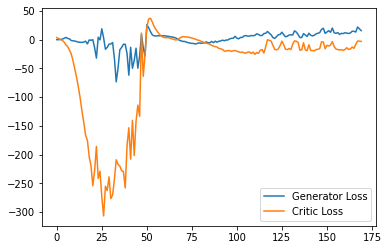

Step 3450: Generator loss: 10.118060173988342, critic loss: -13.512707991600042


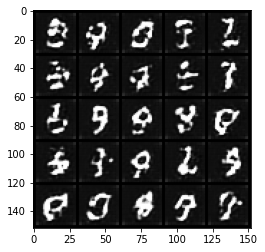

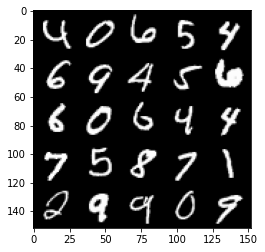

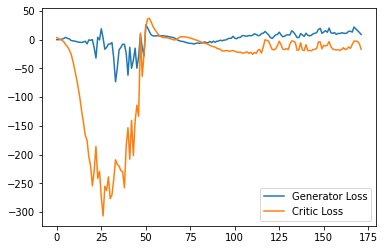

Step 3500: Generator loss: 17.952429218292238, critic loss: -3.6623373575210563


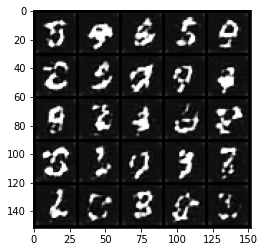

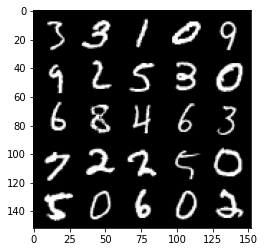

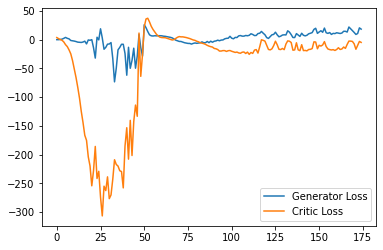

Step 3550: Generator loss: 12.242540121078491, critic loss: -12.001611666679384


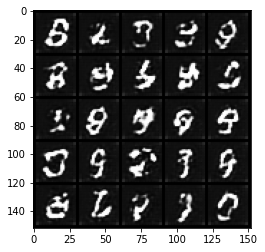

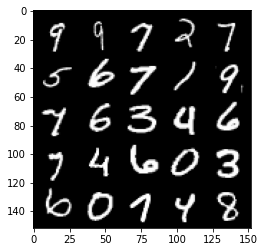

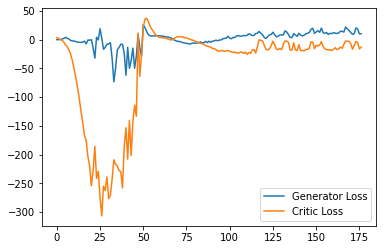

Step 3600: Generator loss: 17.422930850982667, critic loss: -3.850275360107422


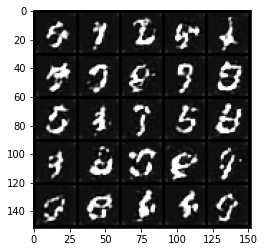

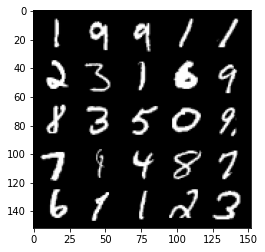

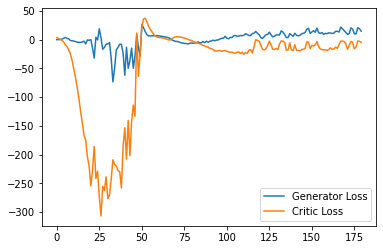

Step 3650: Generator loss: 9.795838780403137, critic loss: -11.663945847034453


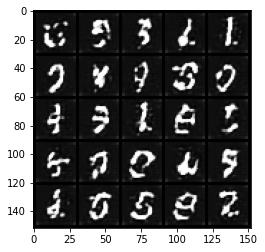

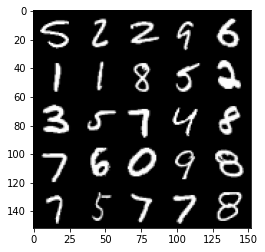

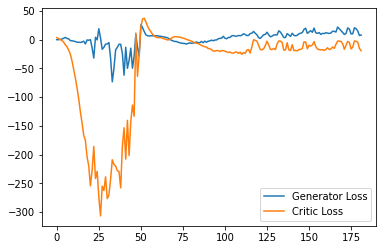

Step 3700: Generator loss: 17.75681816101074, critic loss: -2.2002988243103023


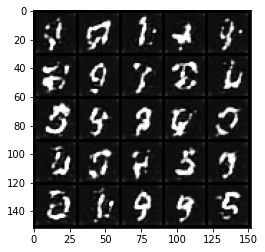

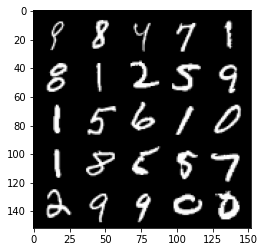

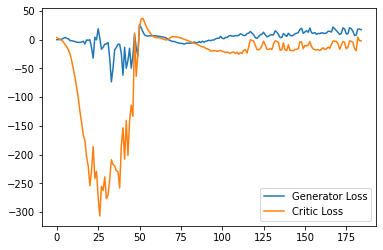

Step 3750: Generator loss: 14.119676208496093, critic loss: -3.1869773540496826


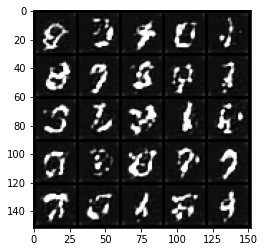

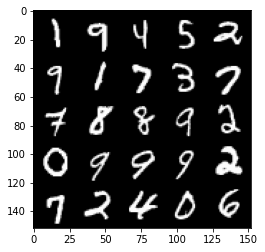

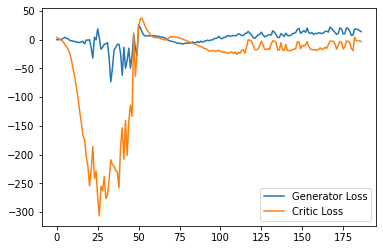

Step 3800: Generator loss: 10.136266145706177, critic loss: -10.010483022689822


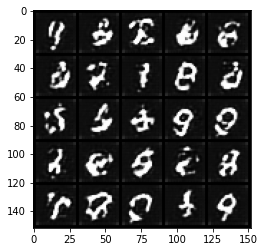

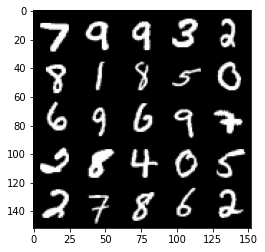

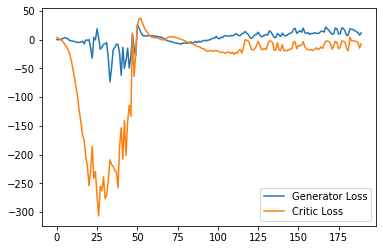

Step 3850: Generator loss: 17.77134553909302, critic loss: -2.47609499168396


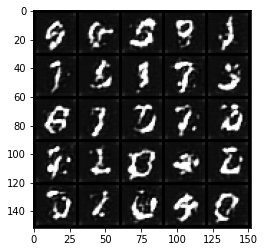

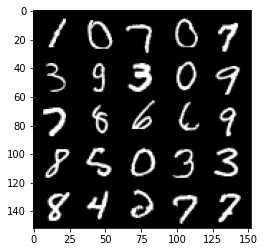

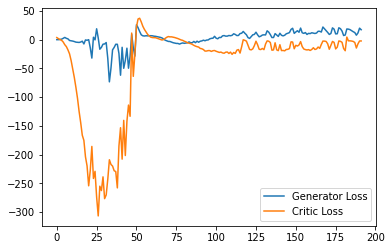

Step 3900: Generator loss: 12.758398933410644, critic loss: -4.998527066230773


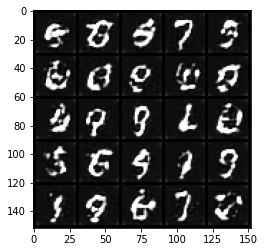

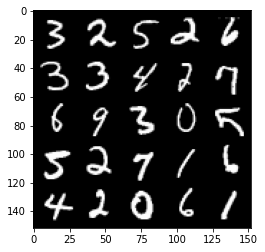

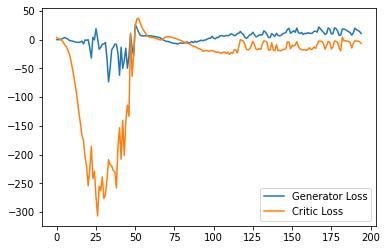

Step 3950: Generator loss: 13.019395704269408, critic loss: -6.60201336240769


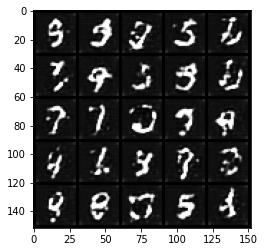

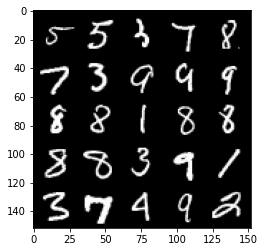

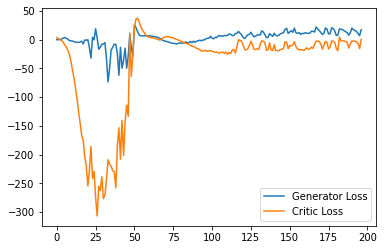

Step 4000: Generator loss: 10.186924468278885, critic loss: -11.471140294551846


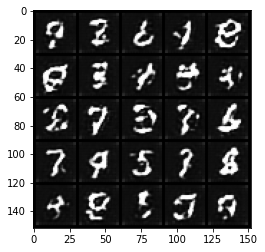

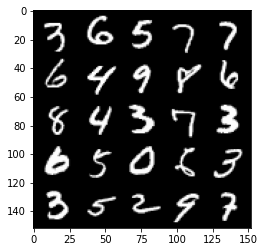

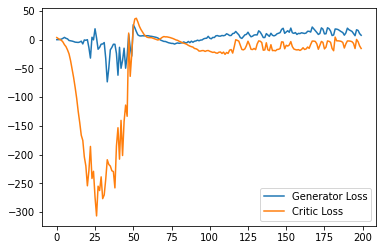

Step 4050: Generator loss: 10.851941021978854, critic loss: -10.082322178840638


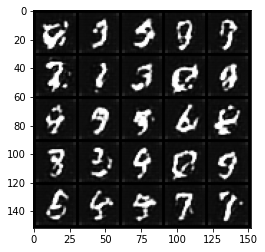

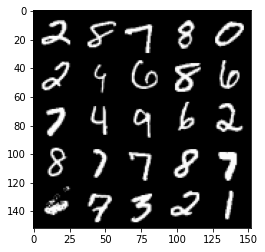

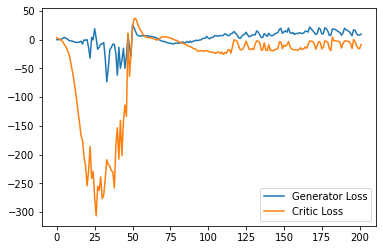

Step 4100: Generator loss: 17.42759780883789, critic loss: -2.381452984809876


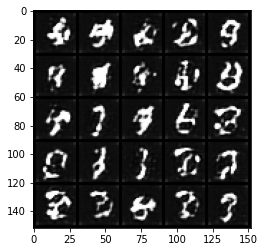

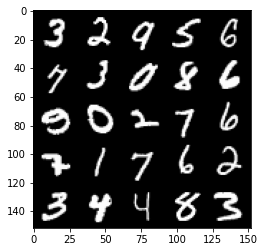

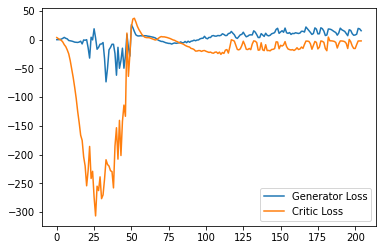

Step 4150: Generator loss: 13.64297233581543, critic loss: -3.3710386800765986


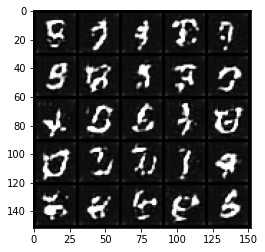

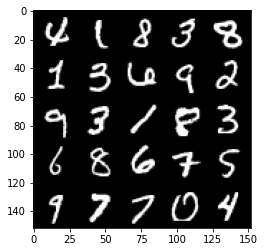

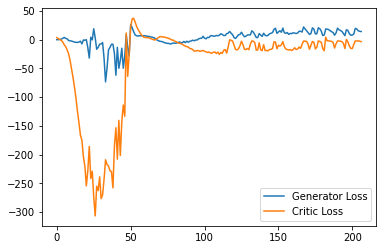

Step 4200: Generator loss: 9.857257146835327, critic loss: -8.225522885322572


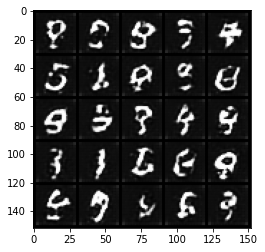

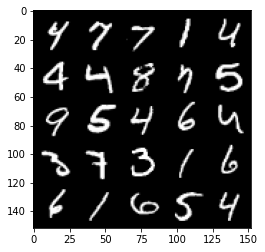

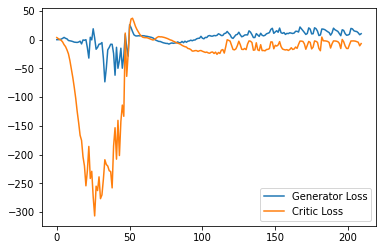

Step 4250: Generator loss: 10.283388682603835, critic loss: -11.13681469726563


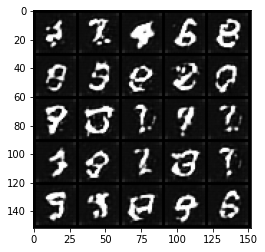

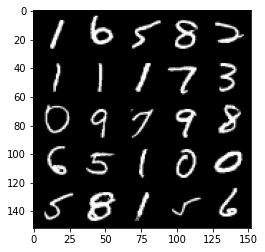

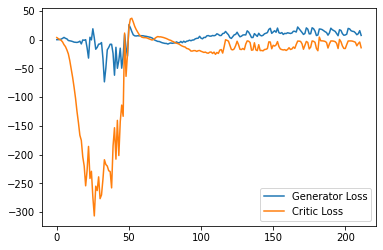

Step 4300: Generator loss: 7.709099221229553, critic loss: -16.82631081676483


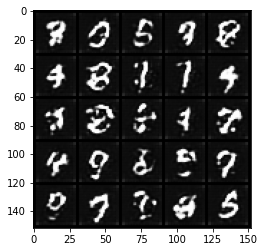

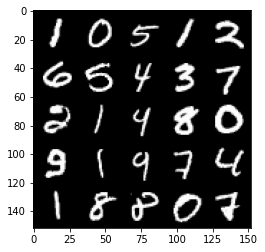

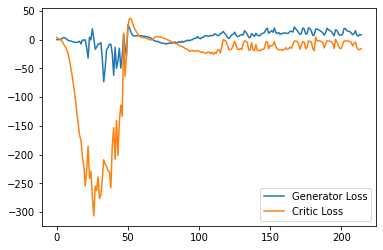

Step 4350: Generator loss: 9.169109861552716, critic loss: -16.494784861326217


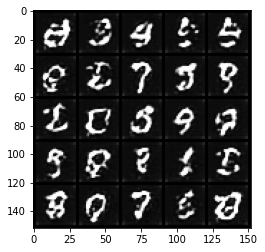

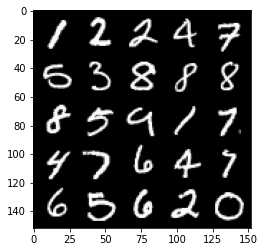

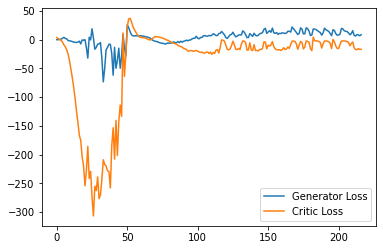

Step 4400: Generator loss: 12.935086755752563, critic loss: -4.404457984924317


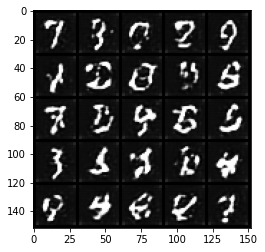

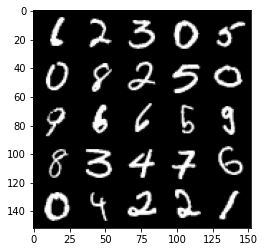

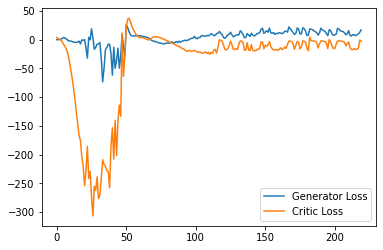

Step 4450: Generator loss: 13.80357557296753, critic loss: -3.517598704338074


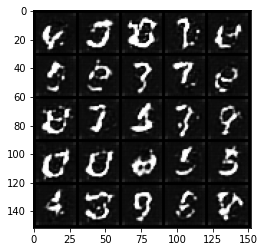

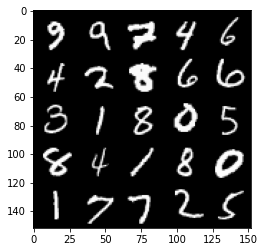

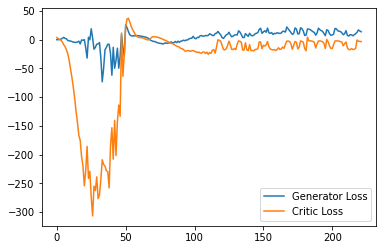

Step 4500: Generator loss: 7.810221344232559, critic loss: -14.145965258121489


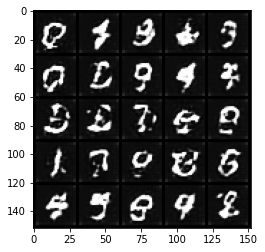

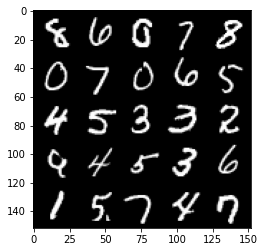

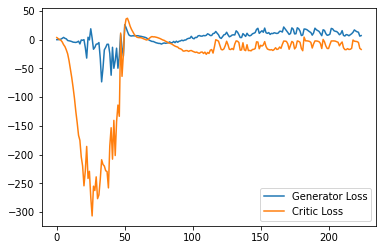

Step 4550: Generator loss: 9.74186059474945, critic loss: -14.918107240676882


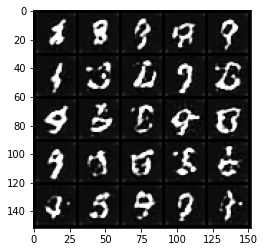

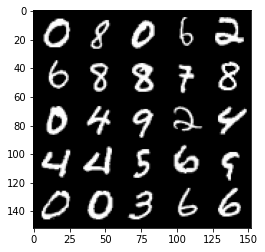

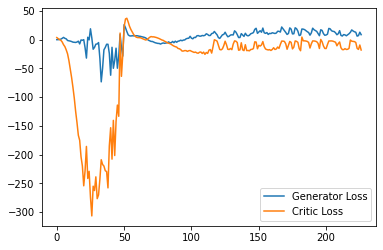

Step 4600: Generator loss: 11.067640775740147, critic loss: -8.46401321411133


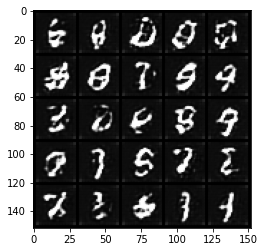

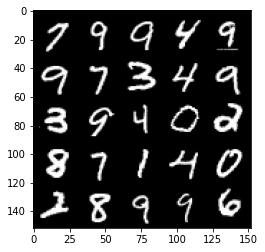

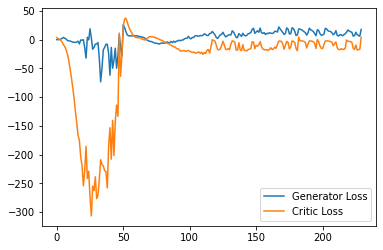

Step 4650: Generator loss: 16.65169340133667, critic loss: -3.735971194267273


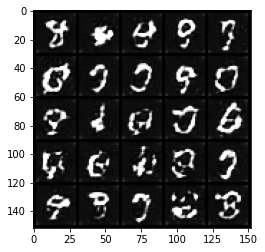

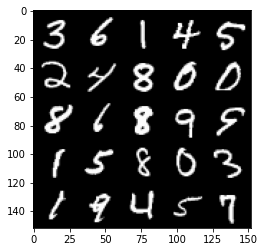

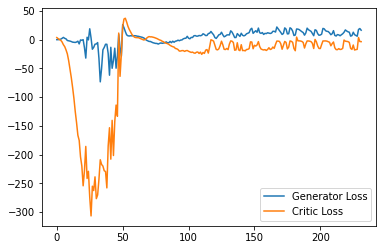

Step 4700: Generator loss: 7.064756492674351, critic loss: -14.287060681343073


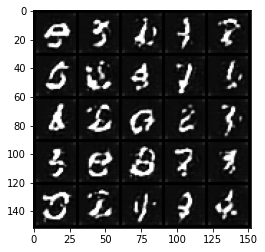

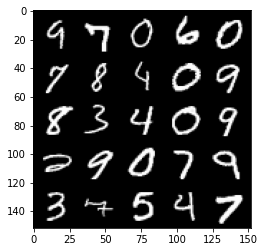

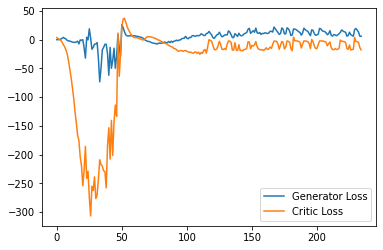

Step 4750: Generator loss: 10.547833391427993, critic loss: -11.899636693000794


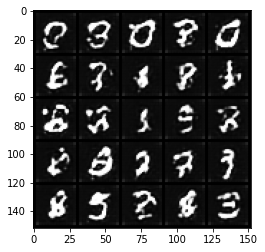

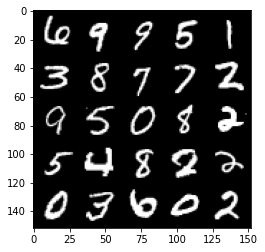

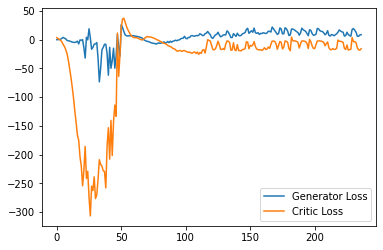

Step 4800: Generator loss: 16.05867296218872, critic loss: -3.9025866184234617


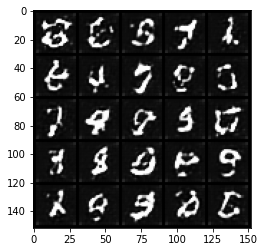

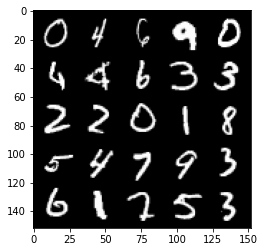

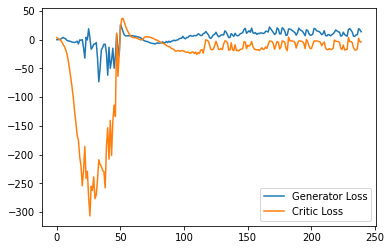

Step 4850: Generator loss: 8.367558388710021, critic loss: -11.92843187236786


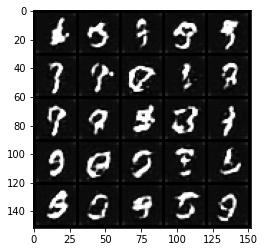

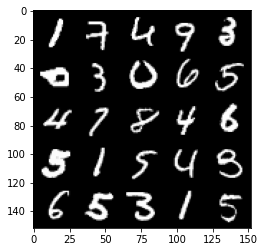

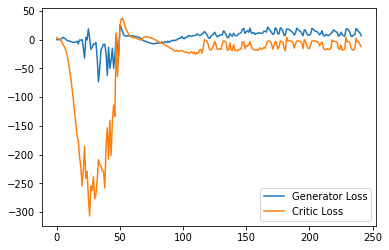

Step 4900: Generator loss: 9.04472661137581, critic loss: -18.249539482116703


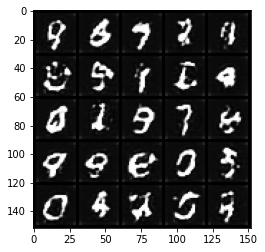

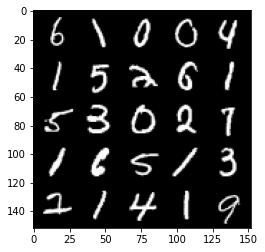

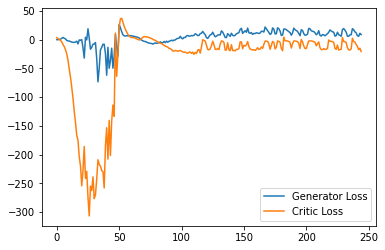

Step 4950: Generator loss: 12.541185996532441, critic loss: -9.695664896488188


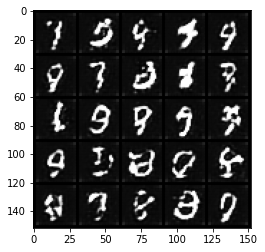

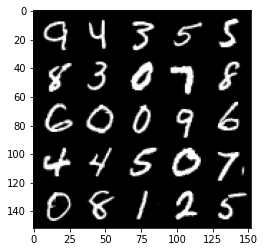

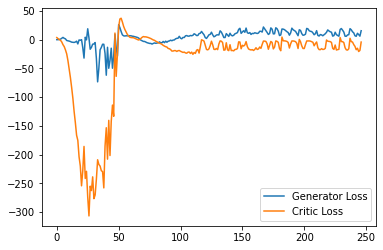

Step 5000: Generator loss: 11.582188546657562, critic loss: -4.331175076484683


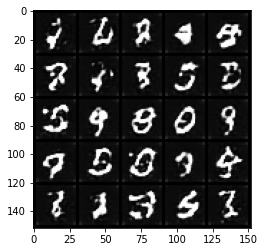

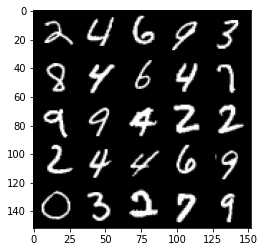

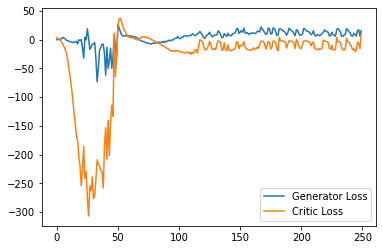

Step 5050: Generator loss: 16.78379409790039, critic loss: -2.520542883872986


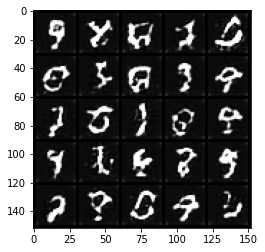

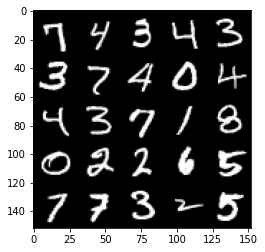

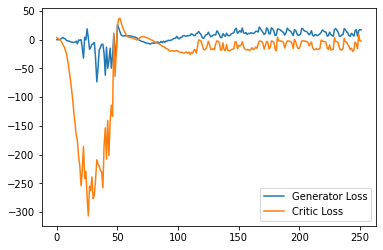

Step 5100: Generator loss: 14.942774238586425, critic loss: -2.870409639358521


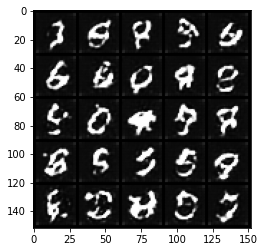

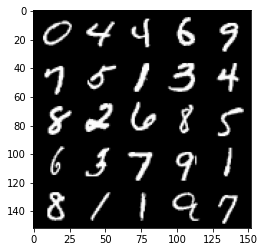

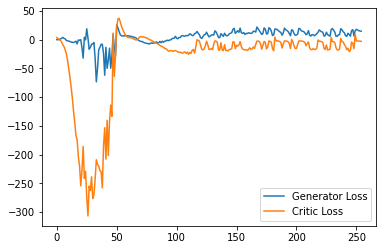

Step 5150: Generator loss: 13.454320602416992, critic loss: -3.638758141517639


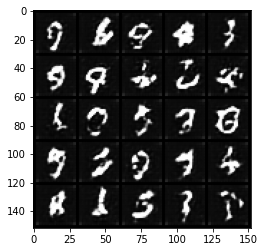

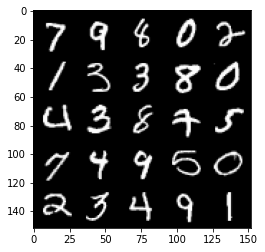

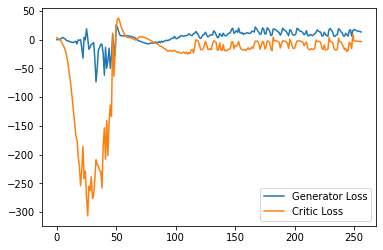

Step 5200: Generator loss: 10.694794435501098, critic loss: -7.712711532592772


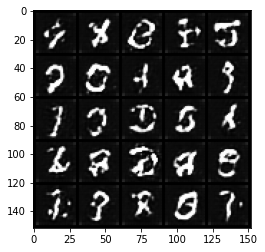

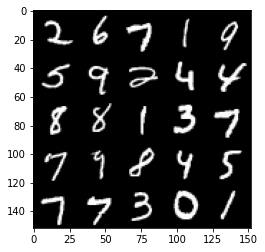

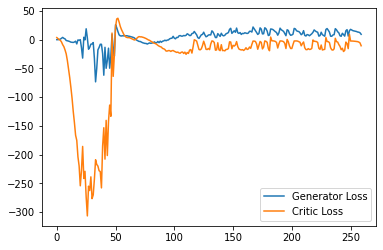

Step 5250: Generator loss: 7.2334778136014934, critic loss: -16.630910030364998


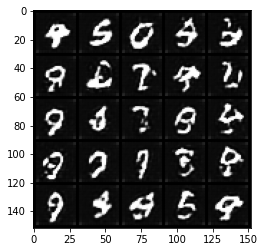

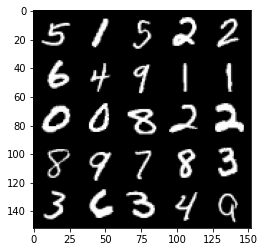

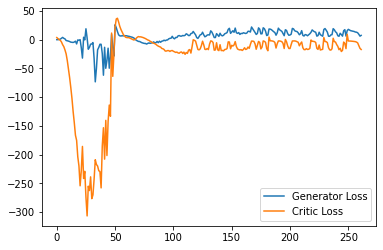

Step 5300: Generator loss: 8.740456907749175, critic loss: -15.856680658102032


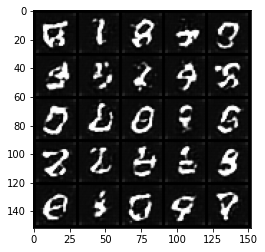

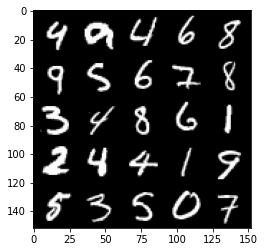

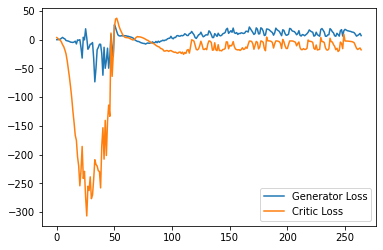

Step 5350: Generator loss: 8.72456325829029, critic loss: -17.863876988649366


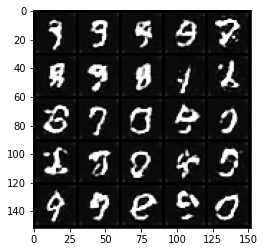

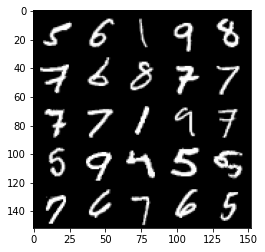

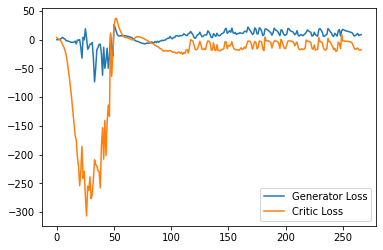

Step 5400: Generator loss: 14.461692206859588, critic loss: -9.309126997470853


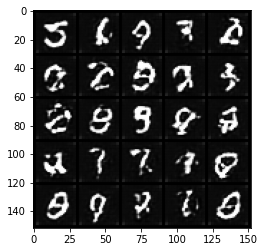

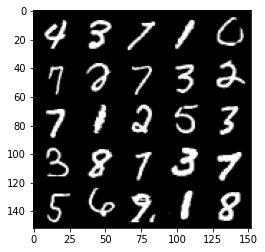

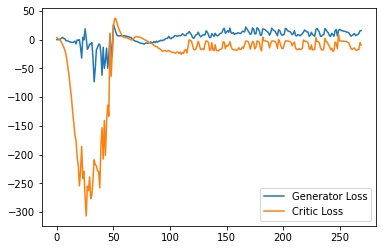

Step 5450: Generator loss: 12.217437008619308, critic loss: -15.437822495937342


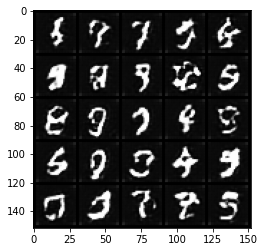

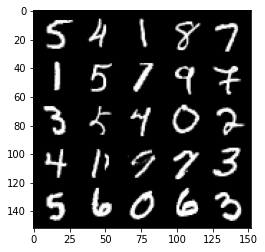

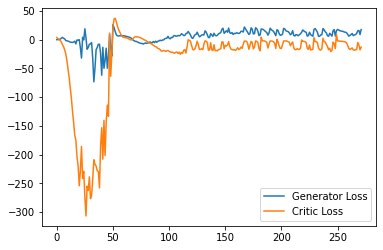

Step 5500: Generator loss: 9.555641613006593, critic loss: -16.720794456958775


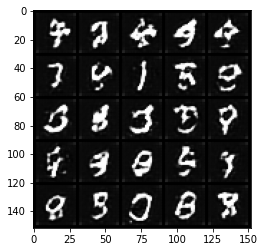

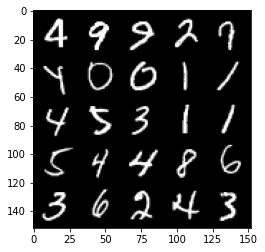

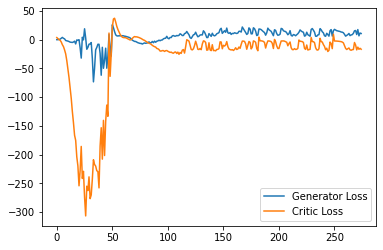

Step 5550: Generator loss: 15.306777376532555, critic loss: -4.774506978988647


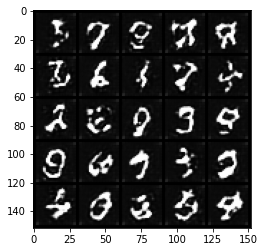

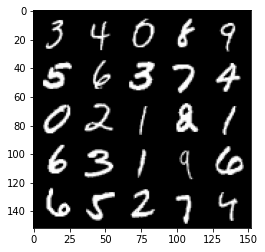

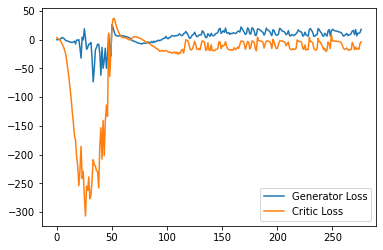

Step 5600: Generator loss: 8.780735768079758, critic loss: -15.112400112628936


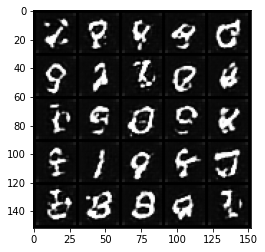

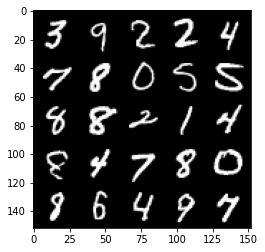

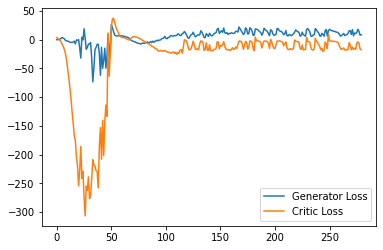

Step 5650: Generator loss: 8.99955258578062, critic loss: -11.30850306367874


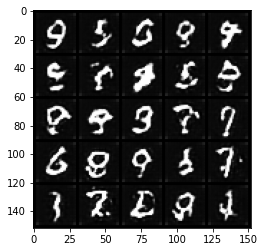

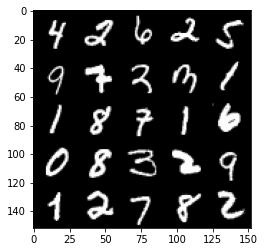

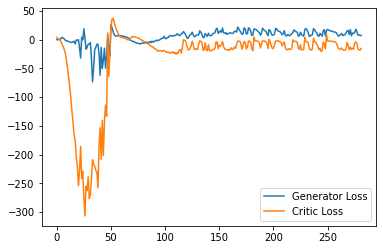

Step 5700: Generator loss: 18.04381185531616, critic loss: -3.182163887023925


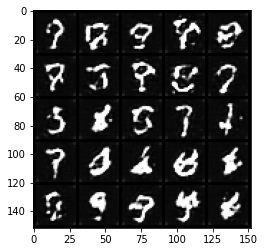

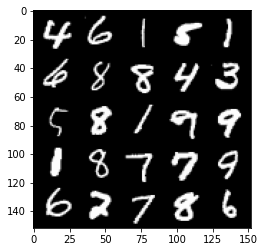

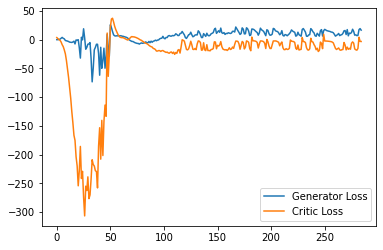

Step 5750: Generator loss: 12.624983291625977, critic loss: -4.874248471260071


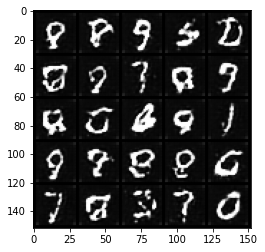

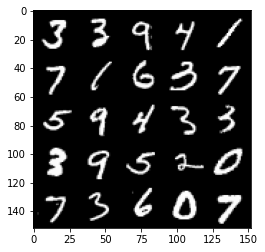

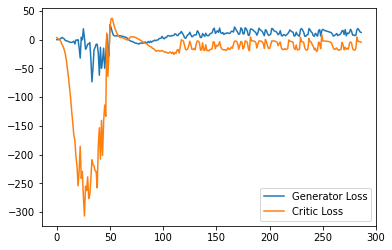

Step 5800: Generator loss: 6.5383063644170765, critic loss: -17.247604617118835


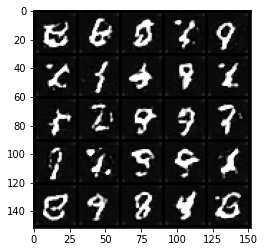

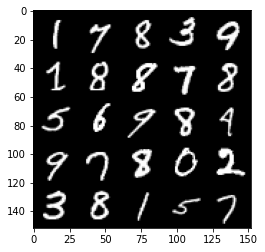

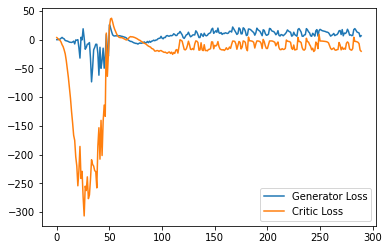

Step 5850: Generator loss: 11.80330101184547, critic loss: -9.881006953239442


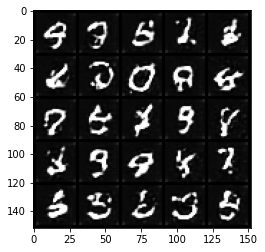

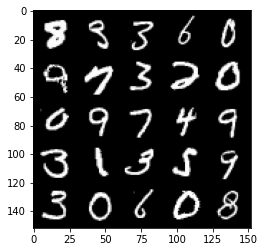

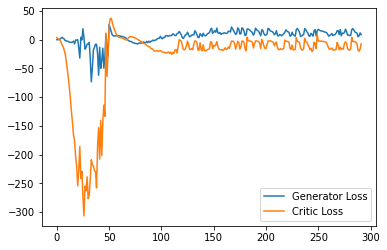

Step 5900: Generator loss: 16.910604305267334, critic loss: -3.4223375110626226


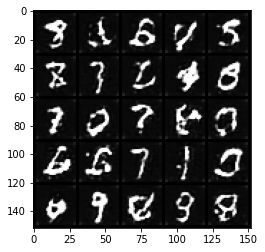

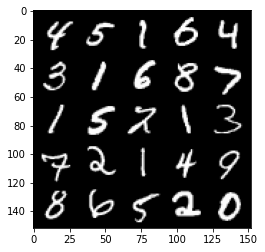

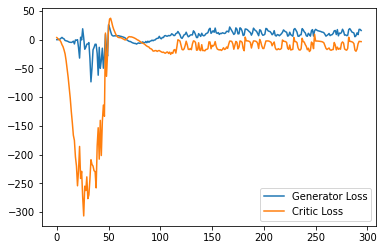

Step 5950: Generator loss: 11.47019928097725, critic loss: -9.898187880039215


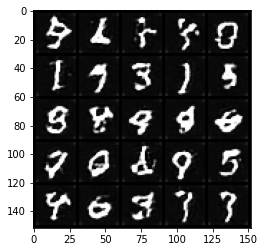

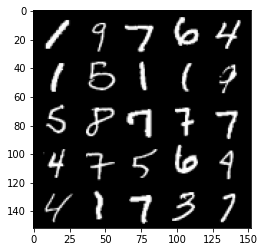

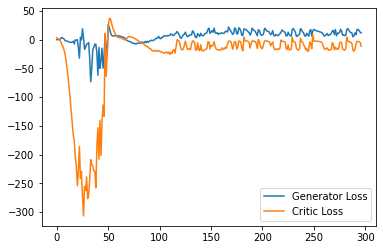

Step 6000: Generator loss: 13.041851508617402, critic loss: -4.656955700874327


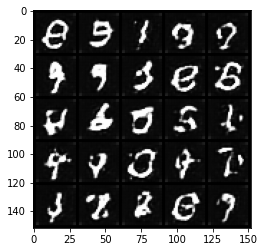

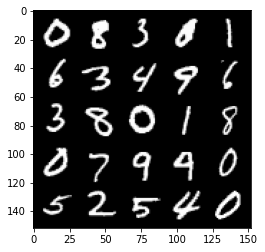

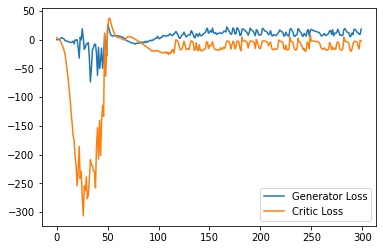

Step 6050: Generator loss: 15.398778438568115, critic loss: -2.3709427194595336


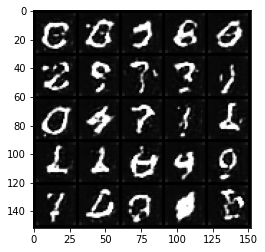

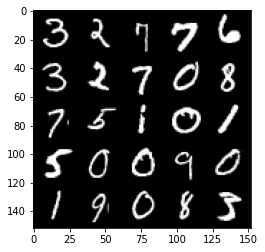

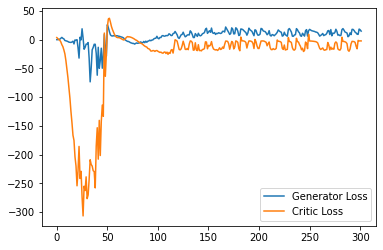

Step 6100: Generator loss: 13.155981578826903, critic loss: -3.4050444965362545


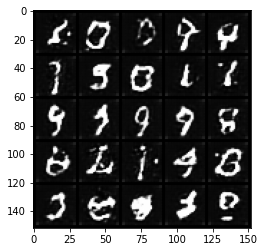

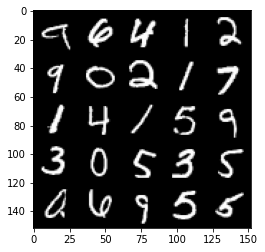

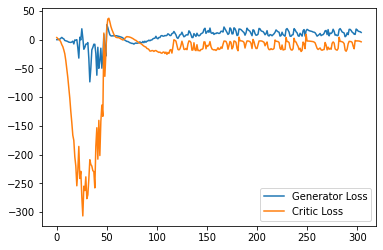

Step 6150: Generator loss: 6.663705332279205, critic loss: -14.029847198724745


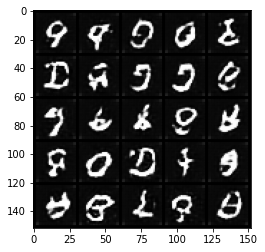

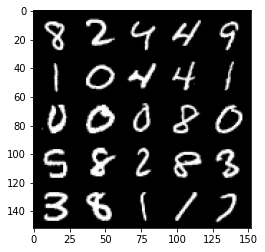

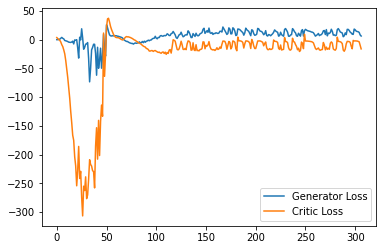

Step 6200: Generator loss: 11.561732139587402, critic loss: -15.125365598678588


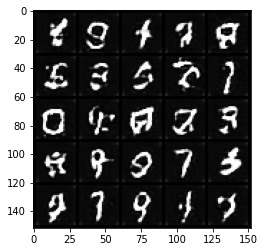

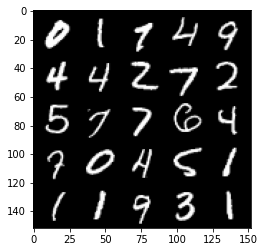

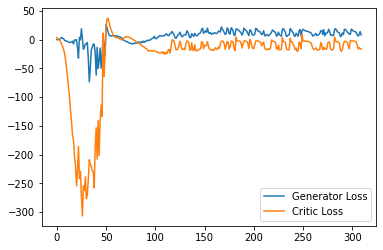

Step 6250: Generator loss: 11.049642549157143, critic loss: -12.036754121303556


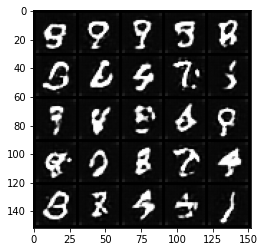

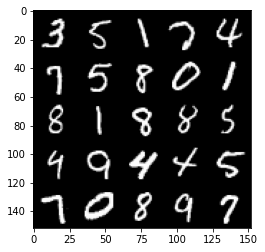

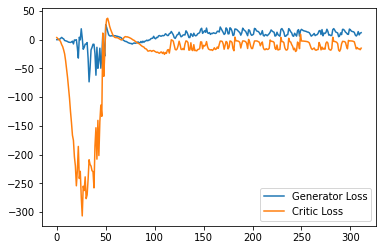

Step 6300: Generator loss: 20.298294486999513, critic loss: -3.3282318944931024


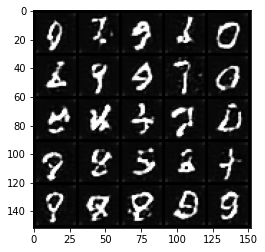

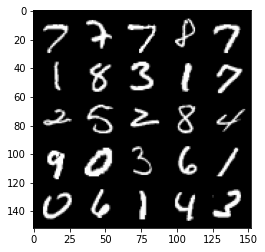

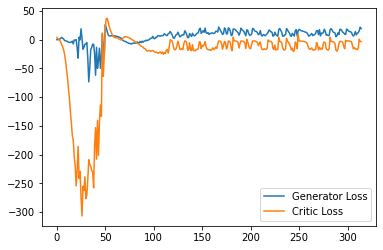

Step 6350: Generator loss: 14.874809594154359, critic loss: -5.0864928913116465


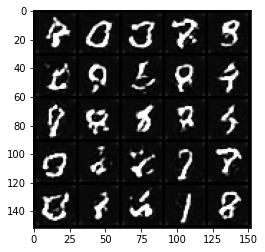

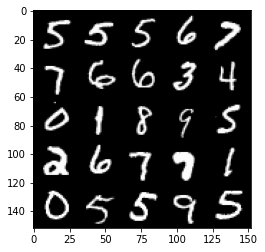

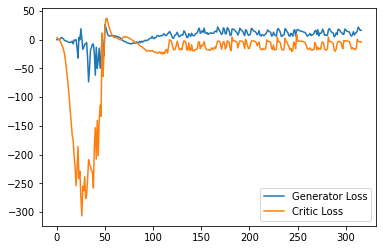

Step 6400: Generator loss: 10.373767414093017, critic loss: -15.766198912143714


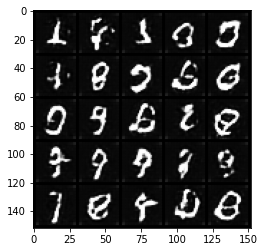

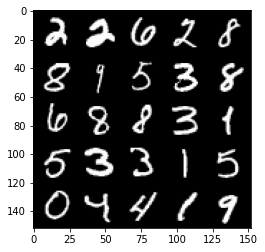

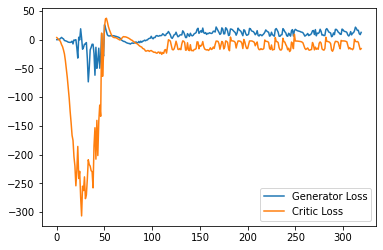

Step 6450: Generator loss: 14.382598972320556, critic loss: -5.88177025985718


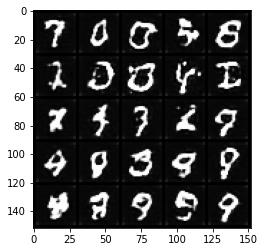

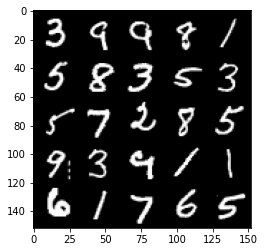

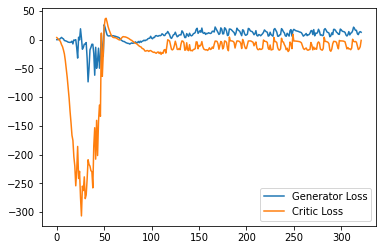

Step 6500: Generator loss: 16.77289264678955, critic loss: -3.3914527463912965


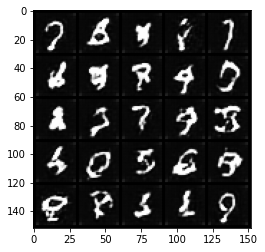

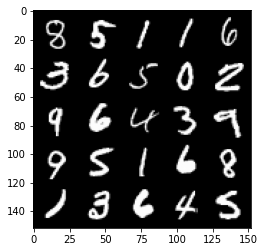

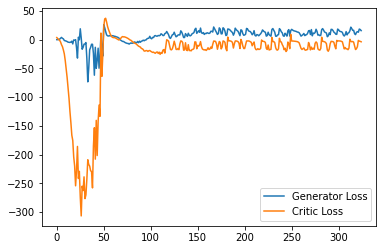

Step 6550: Generator loss: 8.691929073929787, critic loss: -11.659475666046141


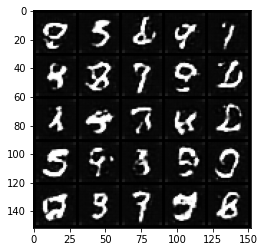

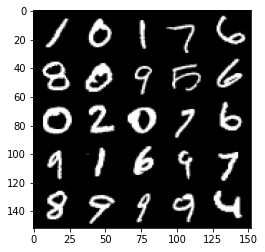

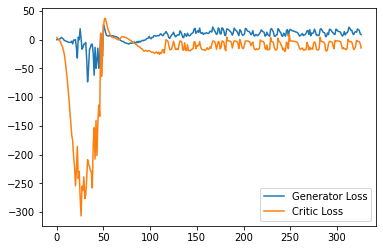

Step 6600: Generator loss: 17.59701114654541, critic loss: -1.7959317071437828


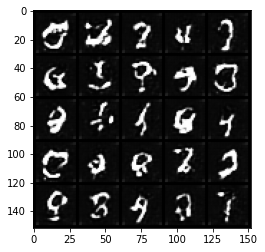

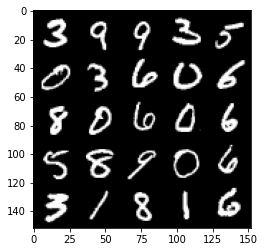

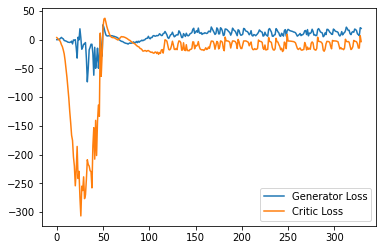

Step 6650: Generator loss: 12.479643806219102, critic loss: -10.481097187519072


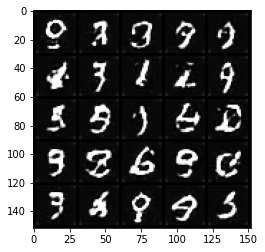

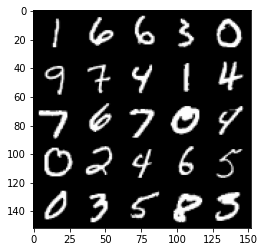

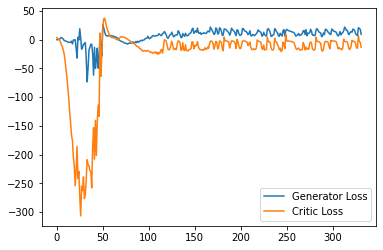

Step 6700: Generator loss: 11.248194397985936, critic loss: -16.1628420753479


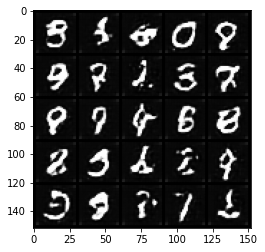

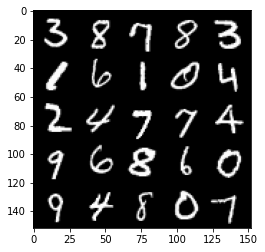

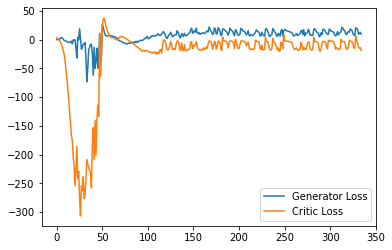

Step 6750: Generator loss: 12.291908397674561, critic loss: -16.155962869167325


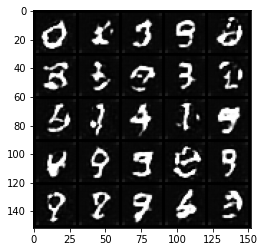

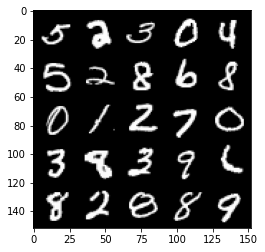

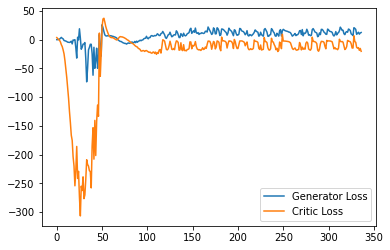

Step 6800: Generator loss: 11.686302719116211, critic loss: -17.727809687376027


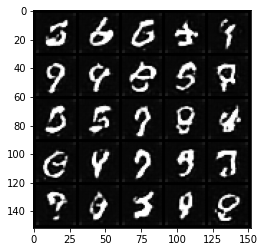

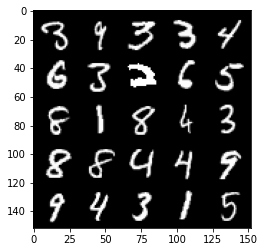

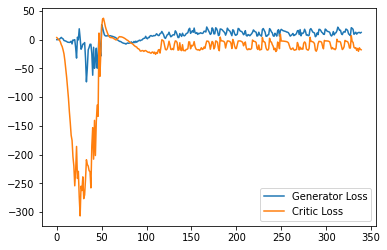

Step 6850: Generator loss: 15.454365773200989, critic loss: -16.828619521141054


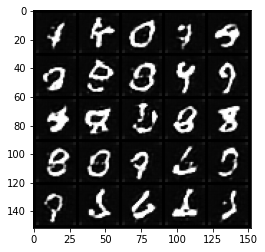

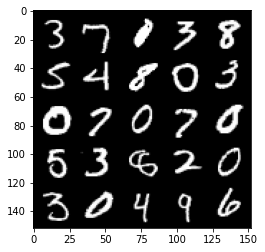

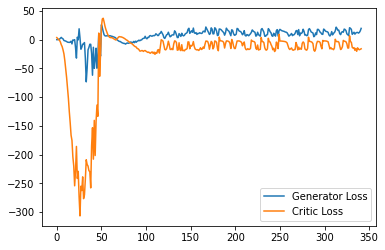

Step 6900: Generator loss: 16.58802131652832, critic loss: -3.120036600351333


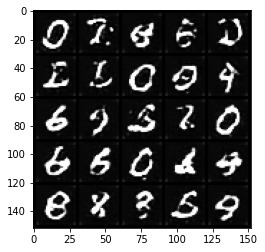

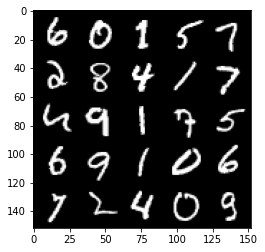

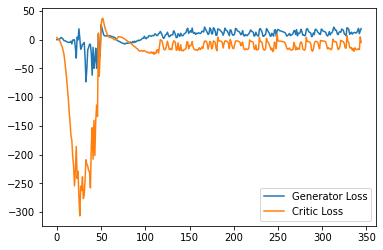

Step 6950: Generator loss: 17.977702312469482, critic loss: -13.878084728240967


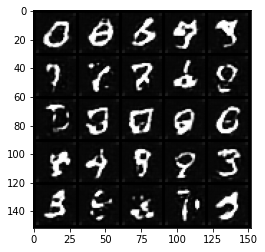

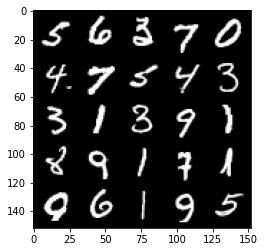

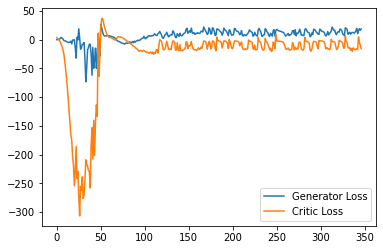

Step 7000: Generator loss: 17.305485363006593, critic loss: -14.555183672904963


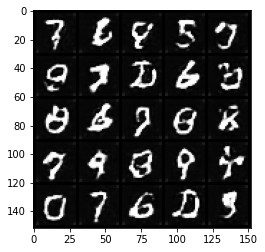

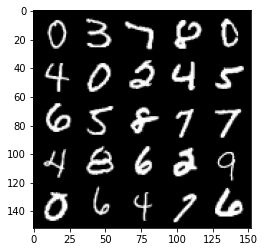

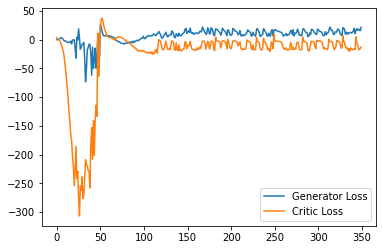

Step 7050: Generator loss: 15.855983266830444, critic loss: -12.942827866077419


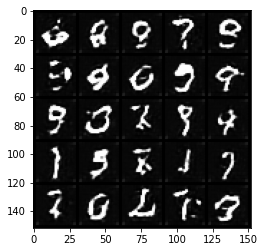

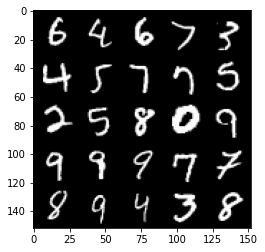

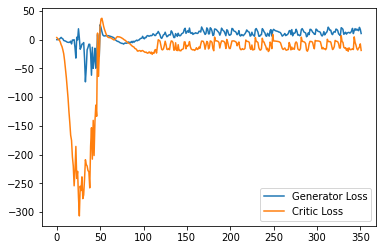

Step 7100: Generator loss: 15.593151321411133, critic loss: -15.245879590034486


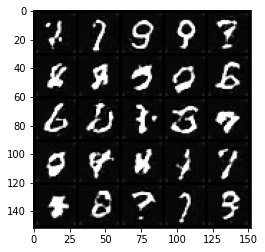

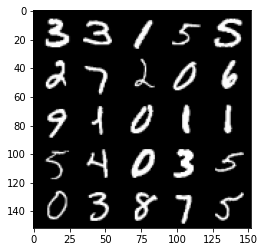

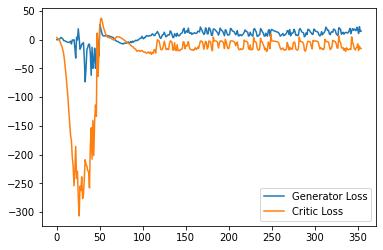

Step 7150: Generator loss: 18.0977640247345, critic loss: -6.101453130722044


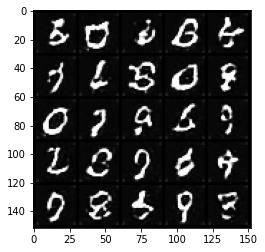

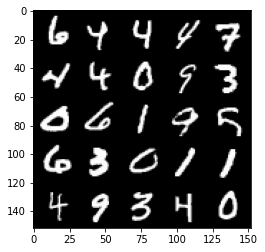

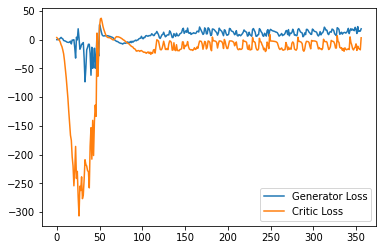

Step 7200: Generator loss: 20.027783470153807, critic loss: -3.3611055011749267


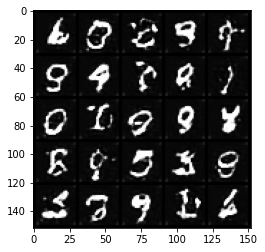

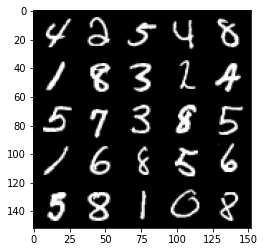

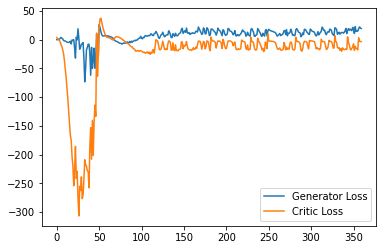

Step 7250: Generator loss: 17.092969017028807, critic loss: -7.3155331597328175


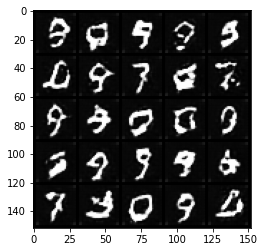

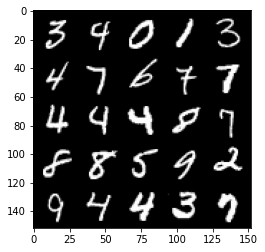

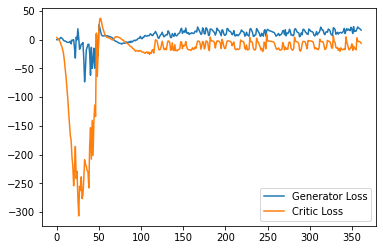

Step 7300: Generator loss: 13.774423785209656, critic loss: -12.607400535821915


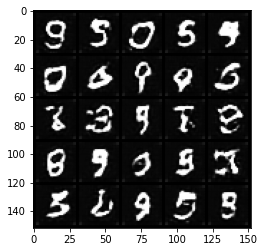

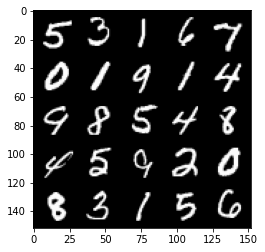

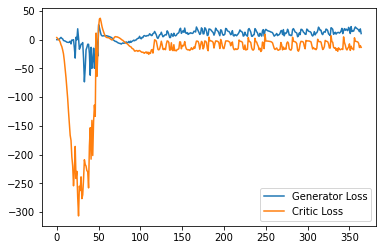

Step 7350: Generator loss: 14.218294472694398, critic loss: -11.853207989454273


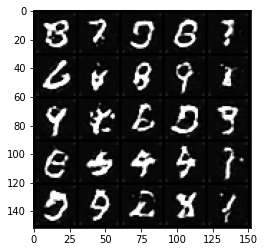

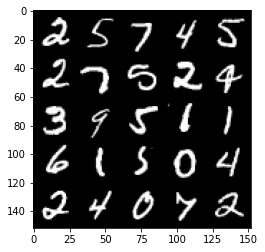

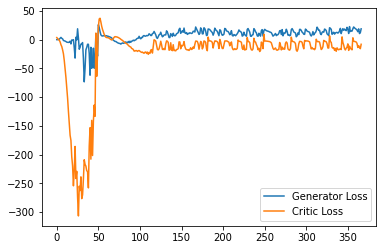

Step 7400: Generator loss: 17.453142681121825, critic loss: -0.6344268064498906


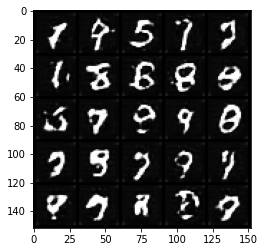

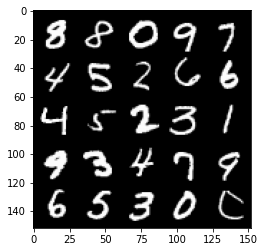

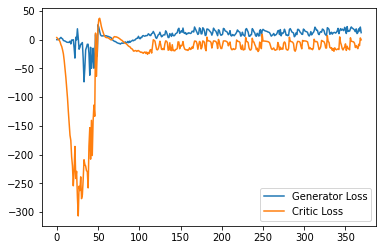

Step 7450: Generator loss: 16.224331998825072, critic loss: -9.879433433055882


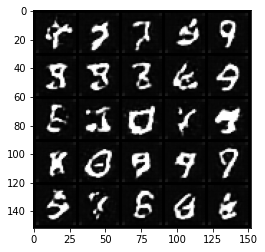

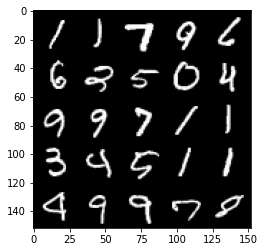

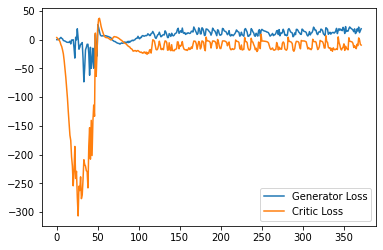

Step 7500: Generator loss: 13.802834692001342, critic loss: -17.551010226964948


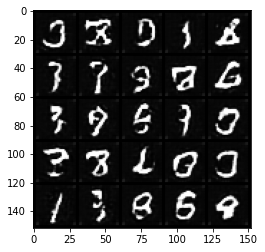

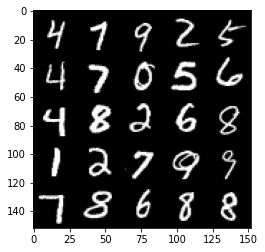

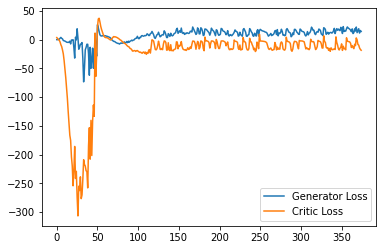

Step 7550: Generator loss: 18.019945163726806, critic loss: -10.484695928096773


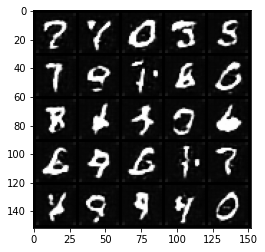

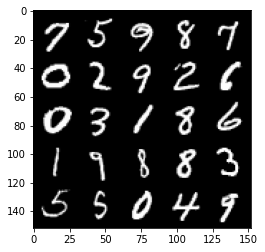

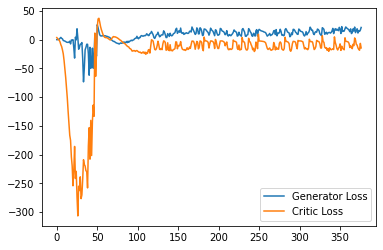

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
